# Digital Health and Human Behavior project course

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
import os
import plotly.io as pio
pio.kaleido.scope.chromium_args = tuple([arg for arg in pio.kaleido.scope.chromium_args if arg != "--disable-dev-shm-usage"])
sns.set(style="whitegrid", font_scale=1.5)
pd.set_option('display.max_columns', None)

## Data loading

In [2]:
# Enumeration of all the files in the dataset folder
ds = sorted(os.listdir('dataset'))
print(f"Element present in the dataset: {len(ds)}")
dataset = {}
for file in ds:
    #print(file)
    dataset[file.split('_')[0]] = pd.read_csv(f"dataset/{file}")

Element present in the dataset: 18


## Data exploration

In [3]:
def get_df_description(df : pd.DataFrame, show_df=False):
    print(f"Rows {df.shape[0]} - Cols {df.shape[1]}")
    null_count = df.isnull().sum(axis=0).sum()
    duplicates_count = df.duplicated().sum()
    print(f"Columns: {list(df.columns)}")
    print(f"Unique ids: {len(df['Id'].unique())}")
    print(f"Total number of null values: {null_count}")
    print(f"Total number of duplicates: {duplicates_count}")
    if show_df:
        print("Dataframe head")
        display(df.head())
        print("Dataframe description")
        display(df.describe())
        print("Dataframe info")
        display(df.info())
        if duplicates_count > 0:
            display(df[df.duplicated(keep=False)])

In [4]:
for key in dataset.keys():
    print(key)
    get_df_description(dataset[key])
    print()

dailyActivity
Rows 940 - Cols 15
Columns: ['Id', 'ActivityDate', 'TotalSteps', 'TotalDistance', 'TrackerDistance', 'LoggedActivitiesDistance', 'VeryActiveDistance', 'ModeratelyActiveDistance', 'LightActiveDistance', 'SedentaryActiveDistance', 'VeryActiveMinutes', 'FairlyActiveMinutes', 'LightlyActiveMinutes', 'SedentaryMinutes', 'Calories']
Unique ids: 33
Total number of null values: 0
Total number of duplicates: 0

dailyCalories
Rows 940 - Cols 3
Columns: ['Id', 'ActivityDay', 'Calories']
Unique ids: 33
Total number of null values: 0
Total number of duplicates: 0

dailyIntensities
Rows 940 - Cols 10
Columns: ['Id', 'ActivityDay', 'SedentaryMinutes', 'LightlyActiveMinutes', 'FairlyActiveMinutes', 'VeryActiveMinutes', 'SedentaryActiveDistance', 'LightActiveDistance', 'ModeratelyActiveDistance', 'VeryActiveDistance']
Unique ids: 33
Total number of null values: 0
Total number of duplicates: 0

dailySteps
Rows 940 - Cols 3
Columns: ['Id', 'ActivityDay', 'StepTotal']
Unique ids: 33
Total nu

In [5]:
get_df_description(dataset['dailyActivity'], show_df=True)

Rows 940 - Cols 15
Columns: ['Id', 'ActivityDate', 'TotalSteps', 'TotalDistance', 'TrackerDistance', 'LoggedActivitiesDistance', 'VeryActiveDistance', 'ModeratelyActiveDistance', 'LightActiveDistance', 'SedentaryActiveDistance', 'VeryActiveMinutes', 'FairlyActiveMinutes', 'LightlyActiveMinutes', 'SedentaryMinutes', 'Calories']
Unique ids: 33
Total number of null values: 0
Total number of duplicates: 0
Dataframe head


,Id,ActivityDate,TotalSteps,TotalDistance,TrackerDistance,LoggedActivitiesDistance,VeryActiveDistance,ModeratelyActiveDistance,LightActiveDistance,SedentaryActiveDistance,VeryActiveMinutes,FairlyActiveMinutes,LightlyActiveMinutes,SedentaryMinutes,Calories
0,1503960366,4/12/2016,13162,8.50,8.50,0.0,1.88,0.55,6.06,0.0,25,13,328,728,1985
1,1503960366,4/13/2016,10735,6.97,6.97,0.0,1.57,0.69,4.71,0.0,21,19,217,776,1797
2,1503960366,4/14/2016,10460,6.74,6.74,0.0,2.44,0.40,3.91,0.0,30,11,181,1218,1776
3,1503960366,4/15/2016,9762,6.28,6.28,0.0,2.14,1.26,2.83,0.0,29,34,209,726,1745
4,1503960366,4/16/2016,12669,8.16,8.16,0.0,2.71,0.41,5.04,0.0,36,10,221,773,1863


Dataframe description


,Id,TotalSteps,TotalDistance,TrackerDistance,LoggedActivitiesDistance,VeryActiveDistance,ModeratelyActiveDistance,LightActiveDistance,SedentaryActiveDistance,VeryActiveMinutes,FairlyActiveMinutes,LightlyActiveMinutes,SedentaryMinutes,Calories
count,9.400000e+02,940.000000,940.000000,940.000000,940.000000,940.000000,940.000000,940.000000,940.000000,940.000000,940.000000,940.000000,940.000000,940.000000
mean,4.855407e+09,7637.910638,5.489702,5.475351,0.108171,1.502681,0.567543,3.340819,0.001606,21.164894,13.564894,192.812766,991.210638,2303.609574
std,2.424805e+09,5087.150742,3.924606,3.907276,0.619897,2.658941,0.883580,2.040655,0.007346,32.844803,19.987404,109.174700,301.267437,718.166862
min,1.503960e+09,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,2.320127e+09,3789.750000,2.620000,2.620000,0.000000,0.000000,0.000000,1.945000,0.000000,0.000000,0.000000,127.000000,729.750000,1828.500000
50%,4.445115e+09,7405.500000,5.245000,5.245000,0.000000,0.210000,0.240000,3.365000,0.000000,4.000000,6.000000,199.000000,1057.500000,2134.000000
75%,6.962181e+09,10727.000000,7.712500,7.710000,0.000000,2.052500,0.800000,4.782500,0.000000,32.000000,19.000000,264.000000,1229.500000,2793.250000
max,8.877689e+09,36019.000000,28.030001,28.030001,4.942142,21.920000,6.480000,10.710000,0.110000,210.000000,143.000000,518.000000,1440.000000,4900.000000


Dataframe info
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 940 entries, 0 to 939
Data columns (total 15 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Id                        940 non-null    int64  
 1   ActivityDate              940 non-null    object 
 2   TotalSteps                940 non-null    int64  
 3   TotalDistance             940 non-null    float64
 4   TrackerDistance           940 non-null    float64
 5   LoggedActivitiesDistance  940 non-null    float64
 6   VeryActiveDistance        940 non-null    float64
 7   ModeratelyActiveDistance  940 non-null    float64
 8   LightActiveDistance       940 non-null    float64
 9   SedentaryActiveDistance   940 non-null    float64
 10  VeryActiveMinutes         940 non-null    int64  
 11  FairlyActiveMinutes       940 non-null    int64  
 12  LightlyActiveMinutes      940 non-null    int64  
 13  SedentaryMinutes          940 non-null    int64  


None

In [6]:
# Tracker distance != Total distance
diff_instances = dataset['dailyActivity'].query('TrackerDistance != TotalDistance')[['TrackerDistance', 'TotalDistance']]
diff_list = diff_instances.values.tolist()
diff_list = [item[1]-item[0] for item in diff_list]
print(f"Max untracked distance: {round(max(diff_list),3)}")
len(diff_instances)
print(f"{(round(len(diff_instances)/len(dataset['dailyActivity'])*100, 2))}% of the dataset has different values for TrackerDistance and TotalDistance")

Max untracked distance: 1.83
1.6% of the dataset has different values for TrackerDistance and TotalDistance


Let's remove datapoints with different tracker distance wrt total distance

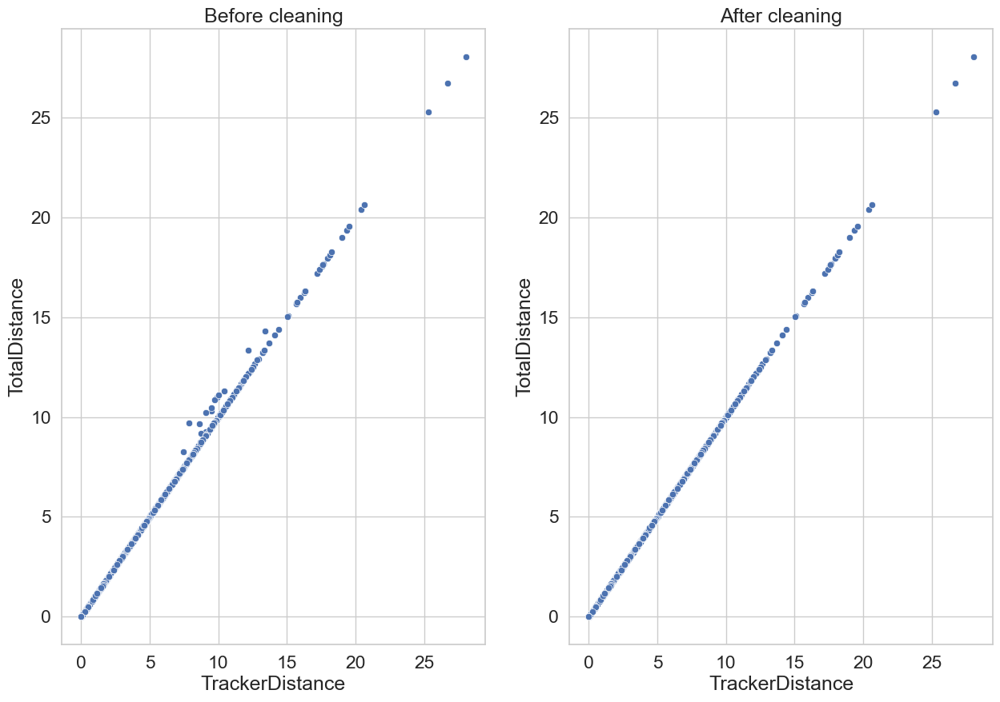

In [7]:
fig, ax = plt.subplots(figsize=(15, 10), ncols=2, nrows=1)
sns.scatterplot(x='TrackerDistance', y='TotalDistance', data=dataset['dailyActivity'], ax=ax[0]).set_title('Before cleaning')
dataset['dailyActivity'] = dataset['dailyActivity'].query('TrackerDistance == TotalDistance')
sns.scatterplot(x='TrackerDistance', y='TotalDistance', data=dataset['dailyActivity'], ax=ax[1]).set_title('After cleaning')
fig.savefig('figures/distance_comparison.png')

In [8]:
# LoggedActivitiesDistance
non_null_lad = dataset['dailyActivity'].query('LoggedActivitiesDistance != 0')
print(f"LoggedActivitiesDistance not null records: {len(non_null_lad)} ({round(len(non_null_lad)/len(dataset['dailyActivity'])*100, 2)}% of the dataset records)")

LoggedActivitiesDistance not null records: 17 (1.84% of the dataset records)


Only 2% of the records have LoggedActivities distance not null, for this reason the column can be dropped

In [9]:
dataset['dailyActivity'].drop(columns=['LoggedActivitiesDistance'], inplace=True)

In [10]:
fig = px.scatter(dataset['dailyActivity'], x='TrackerDistance', y='TotalDistance', trendline='ols',color='ActivityDate', title='TrackerDistance vs TotalDistance')
fig.show()
# fig.write_image('figures/distance_trendline.png', scale=3)

Let's rename and create some new columns

In [11]:
df_activity = dataset['dailyActivity'].copy(deep=True)
df_activity.rename(columns={'ActivityDate': 'Date', 'FairlyActiveMinutes': 'ModeratelyActiveMinutes'}, inplace=True)
df_activity.set_index('Date', inplace=True)
df_activity.index = pd.to_datetime(df_activity.index, format='%m/%d/%Y')
df_activity['Weekday'] = df_activity.index.day_name()
df_activity['TotalActiveMinutes'] = df_activity['VeryActiveMinutes'] + df_activity['ModeratelyActiveMinutes']
df_activity['TotalActiveHours'] = df_activity['TotalActiveMinutes'] / 60.0
df_activity['TotalTrackedMinutes'] = df_activity['TotalActiveMinutes'] + df_activity['LightlyActiveMinutes'] + df_activity['SedentaryMinutes']
df_activity['TotalTrackedHours'] = df_activity['TotalTrackedMinutes'] / 60.0
days_ord = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']

In [12]:
df_activity.dtypes

Id                            int64
TotalSteps                    int64
TotalDistance               float64
TrackerDistance             float64
VeryActiveDistance          float64
ModeratelyActiveDistance    float64
LightActiveDistance         float64
SedentaryActiveDistance     float64
VeryActiveMinutes             int64
ModeratelyActiveMinutes       int64
LightlyActiveMinutes          int64
SedentaryMinutes              int64
Calories                      int64
Weekday                      object
TotalActiveMinutes            int64
TotalActiveHours            float64
TotalTrackedMinutes           int64
TotalTrackedHours           float64
dtype: object

In [13]:
df_activity.describe()

,Id,TotalSteps,TotalDistance,TrackerDistance,VeryActiveDistance,ModeratelyActiveDistance,LightActiveDistance,SedentaryActiveDistance,VeryActiveMinutes,ModeratelyActiveMinutes,LightlyActiveMinutes,SedentaryMinutes,Calories,TotalActiveMinutes,TotalActiveHours,TotalTrackedMinutes,TotalTrackedHours
count,9.250000e+02,925.000000,925.000000,925.000000,925.000000,925.000000,925.000000,925.000000,925.000000,925.000000,925.000000,925.000000,925.000000,925.000000,925.000000,925.000000,925.000000
mean,4.820652e+09,7529.765405,5.408281,5.408281,1.459697,0.558497,3.310378,0.001384,20.680000,13.415135,190.991351,991.625946,2296.445405,34.095135,0.568252,1216.712432,20.278541
std,2.428857e+09,5048.079415,3.898302,3.898302,2.657874,0.884520,2.036994,0.005586,32.870783,20.075630,108.923252,302.966899,720.542291,43.482937,0.724716,266.475703,4.441262
min,1.503960e+09,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000,0.033333
25%,2.320127e+09,3758.000000,2.600000,2.600000,0.000000,0.000000,1.910000,0.000000,0.000000,0.000000,125.000000,729.000000,1821.000000,0.000000,0.000000,989.000000,16.483333
50%,4.445115e+09,7328.000000,5.180000,5.180000,0.190000,0.230000,3.310000,0.000000,3.000000,6.000000,196.000000,1061.000000,2124.000000,18.000000,0.300000,1440.000000,24.000000
75%,6.962181e+09,10602.000000,7.570000,7.570000,1.940000,0.790000,4.730000,0.000000,30.000000,19.000000,262.000000,1234.000000,2782.000000,57.000000,0.950000,1440.000000,24.000000
max,8.877689e+09,36019.000000,28.030001,28.030001,21.920000,6.480000,10.710000,0.070000,210.000000,143.000000,518.000000,1440.000000,4900.000000,275.000000,4.583333,1440.000000,24.000000


## Data visualization

In [14]:
fig = px.scatter(df_activity, x='Calories', y='TotalSteps', trendline='ols', size='VeryActiveMinutes',title='TotalSteps vs Calories based on VeryActiveMinutes')
fig.show()
# fig.write_image('figures/calories_vs_totalsteps.png', scale=3)

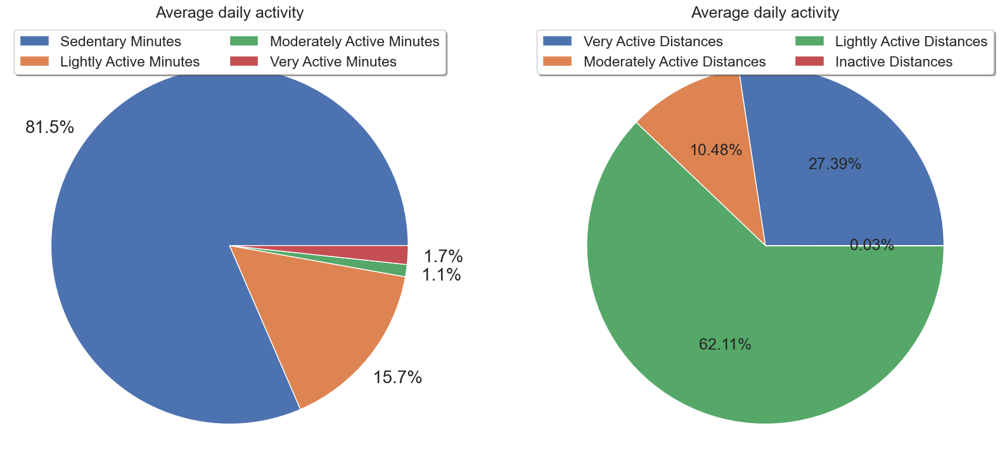

In [15]:
labels = ['Sedentary Minutes', 'Lightly Active Minutes', 'Moderately Active Minutes', 'Very Active Minutes']
values = df_activity[['SedentaryMinutes', 'LightlyActiveMinutes', 'ModeratelyActiveMinutes', 'VeryActiveMinutes']].mean()
fig, ax = plt.subplots(figsize=(20, 40), ncols=2, nrows=1)

ax[0].pie(values, autopct='%1.1f%%', startangle=0, pctdistance=1.2, labeldistance=.6, textprops={'fontsize': 20})
plt.subplots_adjust(bottom=0.5)
ax[0].set_title('Average daily activity')
ax[0].legend(labels, loc='upper center', bbox_to_anchor=(0.5, 1),ncol=2,fancybox=True, shadow=True)

labels = ["Very Active Distances", "Moderately Active Distances", 
         "Lightly Active Distances", "Inactive Distances"]
values = df_activity[["VeryActiveDistance", "ModeratelyActiveDistance", 
               "LightActiveDistance", "SedentaryActiveDistance"]].mean()

ax[1].pie(values, autopct='%1.2f%%', startangle=0, pctdistance=0.6, labeldistance=.6)
plt.subplots_adjust(bottom=0.5)
ax[1].legend(labels, loc='upper center', bbox_to_anchor=(0.5, 1),ncol=2,fancybox=True, shadow=True)
ax[1].set_title('Average daily activity')
fig.savefig('figures/average_daily_activity-compared.png')

Here we can see that users spend on average 81.5% of their time on sedentary activities such as staying sit, watching TV, driving etc. Only 15.7% of the time is spend on lightly active minutes.
Concering distance we can see that most of distance travelled each day is under the lightly active distance umbrella. Almost 28% of the distance travelled is reached through Very Active activities, since for instance, running allows people to travel for more km faster.

Null values for SedentaryActiveDistance: 846 (91.46% of the dataset records)


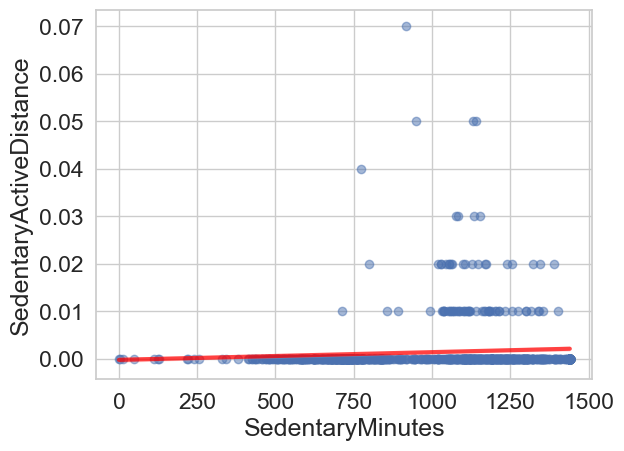

In [16]:
## Count null values of sedentary activities
sedentary_null = df_activity.query('SedentaryActiveDistance == 0')
print(f"Null values for SedentaryActiveDistance: {len(sedentary_null)} ({round(len(sedentary_null)/len(df_activity)*100, 2)}% of the dataset records)")
plot = sns.regplot(x='SedentaryMinutes', y='SedentaryActiveDistance', data=df_activity, label='Sedentary', scatter_kws={'alpha':0.5}, line_kws=dict(alpha=0.7, color='red', linewidth=3))
fig = plot.get_figure()
fig.savefig('figures/sedentary_minutes_vs_distance.png')

We don't have enough records to track a relationship between sedentary active distance, even though we can imagine that the more time is spent in sedentary activity and the less distance will be traveled.

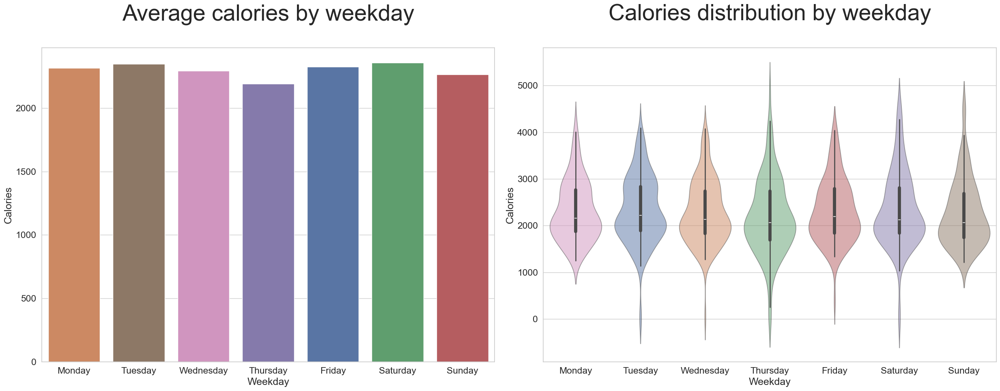

In [17]:
fig, ax = plt.subplots(figsize=(25, 10), ncols=2, nrows=1)
df_activity_avg = df_activity.groupby('Weekday').mean().reset_index()

p1 = sns.barplot(x='Weekday', y='Calories', data=df_activity_avg, hue='Weekday', ax=ax[0], order=days_ord)
p1.set_title('Average calories by weekday\n', fontsize=40)
p2 = sns.violinplot(x="Weekday", y="Calories", data=df_activity, hue='Weekday', ax=ax[1], order=days_ord, alpha=0.5)
p2.set_title('Calories distribution by weekday\n', fontsize=40)
plt.tight_layout()
plt.show()
fig.savefig('figures/avgs_and_dist_by_weekday.png')


,Weekday,Id,TotalSteps,TotalDistance,TrackerDistance,VeryActiveDistance,ModeratelyActiveDistance,LightActiveDistance,SedentaryActiveDistance,VeryActiveMinutes,ModeratelyActiveMinutes,LightlyActiveMinutes,SedentaryMinutes,Calories,TotalActiveMinutes,TotalActiveHours,TotalTrackedMinutes,TotalTrackedHours
0,Friday,4.863983e+09,7347.280000,5.238000,5.238000,1.288960,0.471280,3.453440,0.001840,19.776000,11.872000,202.776000,1000.624000,2325.000000,31.648000,0.527467,1235.048000,20.584133
1,Monday,4.767339e+09,7495.973913,5.346609,5.346609,1.433217,0.550000,3.294870,0.001652,22.017391,13.556522,188.008696,1034.208696,2313.713043,35.573913,0.592899,1257.791304,20.963188
2,Saturday,4.908075e+09,8152.975806,5.854677,5.854677,1.514597,0.677339,3.617177,0.001048,21.919355,15.201613,207.145161,964.282258,2354.967742,37.120968,0.618683,1208.548387,20.142473
3,Sunday,4.847640e+09,6933.231405,5.027190,5.027190,1.488926,0.618017,2.892314,0.000661,19.983471,14.528926,173.975207,990.256198,2263.000000,34.512397,0.575207,1198.743802,19.979063
4,Thursday,4.792376e+09,7296.069444,5.221181,5.221181,1.341181,0.489792,3.254653,0.001597,18.840278,11.819444,183.486111,962.236111,2191.368056,30.659722,0.510995,1176.381944,19.606366
5,Tuesday,4.807640e+09,8000.838926,5.737315,5.737315,1.555906,0.590470,3.433020,0.001477,22.315436,14.248322,194.677852,1006.765101,2344.892617,36.563758,0.609396,1238.006711,20.633445
6,Wednesday,4.770445e+09,7428.142857,5.388231,5.388231,1.573810,0.524966,3.216463,0.001361,20.074830,12.911565,187.299320,988.299320,2290.646259,32.986395,0.549773,1208.585034,20.143084


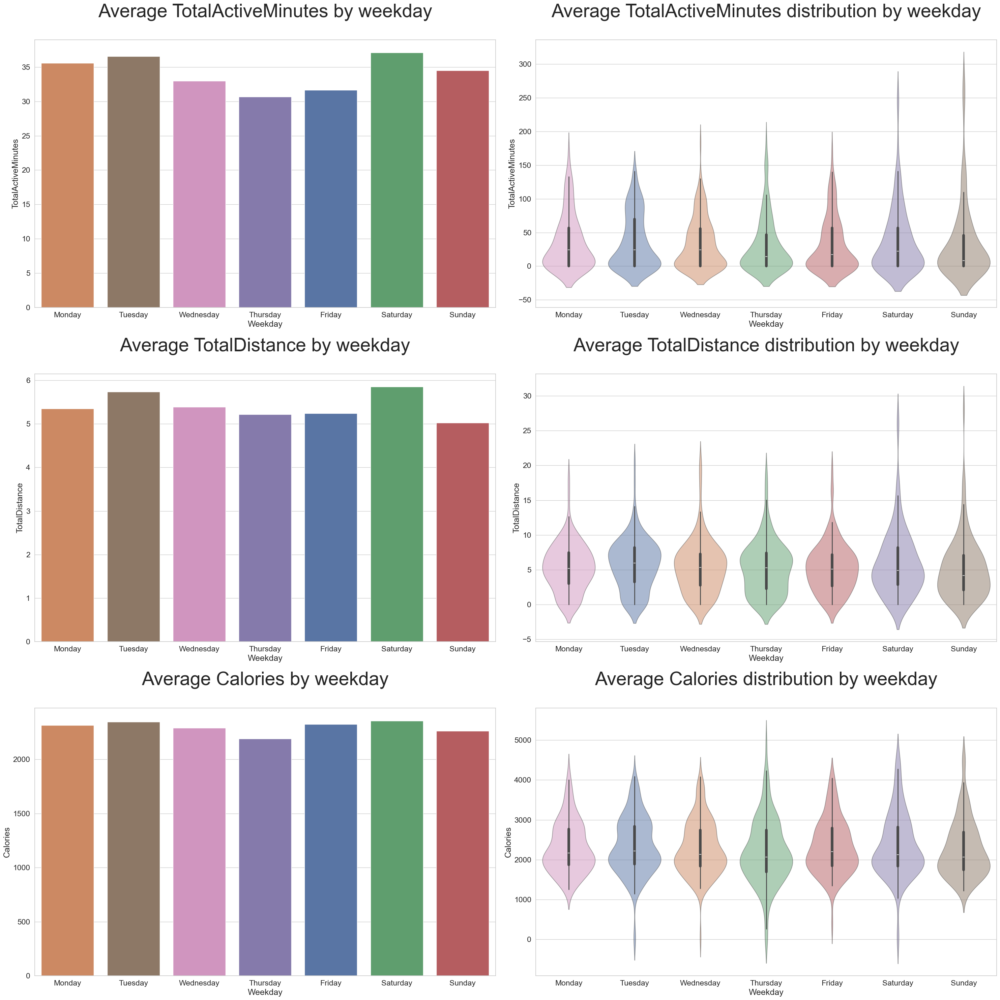

In [18]:
fig, ax = plt.subplots(figsize=(30, 30), ncols=2, nrows=3)
df_activity_avg = df_activity.groupby('Weekday').mean().reset_index()

display(df_activity_avg)

p1 = sns.barplot(x='Weekday', y='TotalActiveMinutes', data=df_activity_avg, hue='Weekday', ax=ax[0][0], order=days_ord)
p1.set_title('Average TotalActiveMinutes by weekday\n', fontsize=40)
p2 = sns.violinplot(x="Weekday", y="TotalActiveMinutes", data=df_activity, hue='Weekday', ax=ax[0][1], order=days_ord, alpha=0.5)
p2.set_title('Average TotalActiveMinutes distribution by weekday\n', fontsize=40)

p3 = sns.barplot(x='Weekday', y='TotalDistance', data=df_activity_avg, hue='Weekday', ax=ax[1][0], order=days_ord)
p3.set_title('Average TotalDistance by weekday\n', fontsize=40)
p4 = sns.violinplot(x="Weekday", y="TotalDistance", data=df_activity, hue='Weekday', ax=ax[1][1], order=days_ord, alpha=0.5)
p4.set_title('Average TotalDistance distribution by weekday\n', fontsize=40)

p5 = sns.barplot(x='Weekday', y='Calories', data=df_activity_avg, hue='Weekday', ax=ax[2][0], order=days_ord)
p5.set_title('Average Calories by weekday\n', fontsize=40)
p6 = sns.violinplot(x="Weekday", y="Calories", data=df_activity, hue='Weekday', ax=ax[2][1], order=days_ord, alpha=0.5)
p6.set_title('Average Calories distribution by weekday\n', fontsize=40)

plt.tight_layout()
plt.show()
fig.savefig('figures/avgs_and_dist_by_weekday.png')

## Definining active/inactive people based on TotalActiveMinutes

/var/folders/97/yjfp60y90vvgjz812_bx179m0000gn/T/ipykernel_91399/363134463.py:22: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




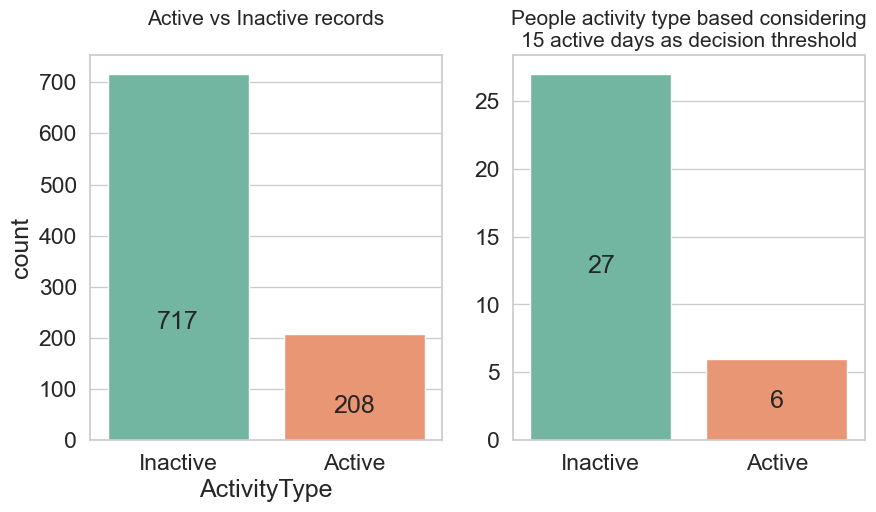

In [19]:
# Creating two group of people Active People and Inactive People
df_activity['ActivityType'] = np.where(df_activity['TotalActiveMinutes'] >= 60, 'Active', 'Inactive')

fig, ax = plt.subplots(figsize=(10, 5), nrows=1, ncols=2)
assert df_activity['ActivityType'].isnull().any() == False

inactive_people = df_activity['Id'].unique().shape[0]
active_days = df_activity[df_activity['ActivityType'] == 'Active'].groupby('Id')['ActivityType'].count()
min_active_days = 15
active_people = active_days[active_days >= min_active_days].shape[0]
inactive_people -= active_people

ax[0].set_title('Active vs Inactive records\n', fontsize=15)
ax[1].set_title(f'People activity type based considering\n{min_active_days} active days as decision threshold', fontsize=15)
cplt = sns.countplot(data=df_activity, x='ActivityType', palette='Set2', hue='ActivityType', ax=ax[0])

for patch in cplt.patches:
    cplt.annotate(f'{int(patch.get_height())}', (patch.get_x() + patch.get_width() / 2., patch.get_height()),
                ha='center', va='center', xytext=(0, -patch.get_height()/4), textcoords='offset points')
assert df_activity[df_activity['ActivityType']=='Active'].shape[0] + df_activity[df_activity['ActivityType']=='Inactive'].shape[0] == df_activity.shape[0], 'Mismatch in the number of records'

cplt2 = sns.barplot(x=['Inactive', 'Active'], y=[inactive_people, active_people], palette='Set2', ax=ax[1])
for patch in cplt2.patches:
    cplt2.annotate(f'{int(patch.get_height())}', (patch.get_x() + patch.get_width() / 2., patch.get_height()/2),
                ha='center', va='center', xytext=(0, -patch.get_height()/4), textcoords='offset points')
fig.savefig('figures/active_vs_inactive.png')

Top 3 active users: ['8053475328' '3977333714' '5577150313']


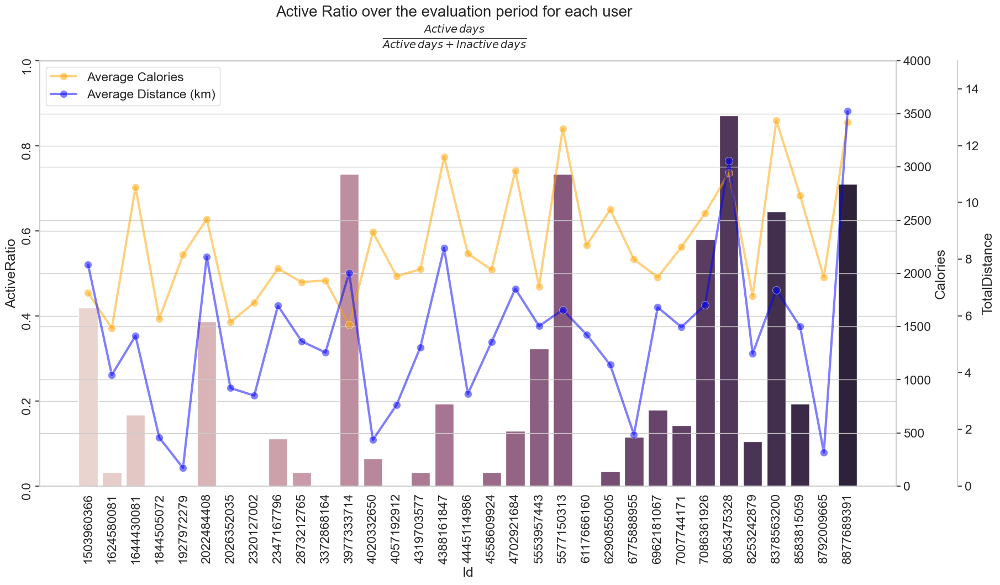

In [20]:
# Plot average number of active people and inactive based on the given period using groupby
ids = df_activity['Id'].unique()
temp_df = df_activity.groupby('Id')['ActivityType'].value_counts().unstack().fillna(0)
temp_df['ActiveRatio'] = temp_df['Active'] / (temp_df['Active'] + temp_df['Inactive'])
fig, ax = plt.subplots(figsize=(20, 10), sharex=True)
plt.suptitle(r'Active Ratio over the evaluation period for each user' '\n' r'$\frac{Active \, days}{Active \, days + Inactive \, days}$', fontsize=20)

ax_twin = ax.twinx()
ax_twin2 = ax.twinx()
ax_twin2.spines['right'].set_position(('outward', 80))
ax.set_ylim(ymax=1, ymin=0)
ax_twin2.set_ylim(ymax=15, ymin=0)
ax_twin.set_ylim(ymax=4000, ymin=0)

calories = df_activity.groupby('Id')[['Calories', 'TotalDistance']].mean()
temp_df = temp_df.merge(calories, left_index=True, right_index=True)

temp_df.reset_index(inplace=True)
temp_df['Id'] = temp_df['Id'].astype('str')
sns.barplot(data=temp_df, x='Id', y='ActiveRatio', ax=ax, hue=temp_df.index)

sns.lineplot(data=temp_df, x='Id', y='Calories', ax=ax_twin, color='orange',\
             marker='.', markersize=20, alpha=0.5, label='Average Calories', linewidth=3)

sns.lineplot(data=temp_df, x='Id', y='TotalDistance', ax=ax_twin2, color='blue',\
             marker='.', markersize=20, alpha=0.5, label='Average Distance (km)', linewidth=3)
   
ax.tick_params(rotation=90)

# Combine legends from both twin axes
handles_twin, labels_twin = ax_twin.get_legend_handles_labels()
handles_twin2, labels_twin2 = ax_twin2.get_legend_handles_labels()

all_handles =  handles_twin + handles_twin2
all_labels =  labels_twin + labels_twin2
ax.legend().set_visible(False)
ax_twin.legend().set_visible(False)
ax_twin2.legend().set_visible(False)
ax.legend(all_handles, all_labels, loc='upper left')
plt.grid()

#get top 3 active users
temp_df.set_index('Id', inplace=True)
top_3_active = temp_df.sort_values(by='ActiveRatio', ascending=False).head(3)
print(f"Top 3 active users: {top_3_active.index.values}")
fig.savefig('figures/active_ratio.png')
# temp_df.sort_values(by='ActiveRatio', ascending=False).tail(10)
# display(temp_df)


## MIPA vs VIPA compliance based on WHO guidelines

In [21]:
df_activity.reset_index(inplace=True)

127.0
26.0
82.0
71.0
WHO_MIPA_Compliant
0    127
1     26
Name: count, dtype: int64
WHO_VIPA_Compliant
0    82
1    71
Name: count, dtype: int64


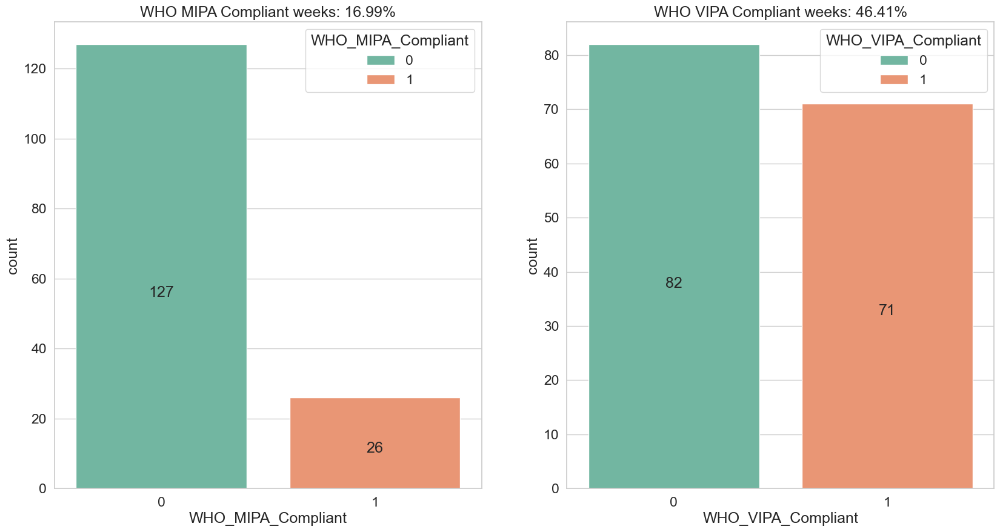

In [22]:
# Analysis on weekly intensity
df_activity['Week'] = df_activity['Date'].dt.isocalendar().week
# df_activity.head()
df_activity_grouped_week = df_activity.groupby(['Id', 'Week'])[['VeryActiveMinutes', 'ModeratelyActiveMinutes']]
df_activity_grouped_week = df_activity_grouped_week.agg({'VeryActiveMinutes': 'sum', 'ModeratelyActiveMinutes': 'sum'})
df_activity_grouped_week.reset_index(inplace=True)
df_activity_grouped_week['WHO_MIPA_Compliant'] = np.where(df_activity_grouped_week['ModeratelyActiveMinutes'] >= 150, 1, 0)
df_activity_grouped_week['WHO_VIPA_Compliant'] = np.where(df_activity_grouped_week['VeryActiveMinutes'] >= 75, 1, 0)
df_activity_grouped_week['Week'] = pd.Categorical(df_activity_grouped_week['Week'], categories=np.arange(df_activity_grouped_week['Week'].min(), df_activity_grouped_week['Week'].max()+1))

fig, ax = plt.subplots(figsize=(20, 10), nrows=1, ncols=2)
sns.countplot(data=df_activity_grouped_week, x='WHO_MIPA_Compliant', palette='Set2', hue='WHO_MIPA_Compliant', ax=ax[0])\
    .set_title(f'WHO MIPA Compliant weeks: {round(100*df_activity_grouped_week["WHO_MIPA_Compliant"].sum()/df_activity_grouped_week.shape[0],2)}%')

sns.countplot(data=df_activity_grouped_week, x='WHO_VIPA_Compliant', palette='Set2', hue='WHO_VIPA_Compliant', ax=ax[1])\
    .set_title(f'WHO VIPA Compliant weeks: {round(100*df_activity_grouped_week["WHO_VIPA_Compliant"].sum() / df_activity_grouped_week.shape[0], 2)}%')

for a in ax:
    for patch in a.patches[:2]:
        print(patch.get_height())
        a.annotate(f'{int(patch.get_height())}', (patch.get_x() + patch.get_width() / 2., patch.get_height() / 2),
                ha='center', va='center', xytext=(0, -patch.get_height()/4), textcoords='offset points')

# Count WHO MIPA Compliant weeks
print(df_activity_grouped_week['WHO_MIPA_Compliant'].value_counts())
print(df_activity_grouped_week['WHO_VIPA_Compliant'].value_counts())
fig.savefig('figures/who_compliant_weeks.png')
# df_activity_grouped_week

Non active users: 9 (27.27%)

Total number of users: 33

Non active users count: 9
Users that were MIPA active for at least 1 weeks: 12 (36.36%)
Users that were VIPA active for at least 1 weeks: 23 (69.7%)
Users that were active for at least 1 weeks: 11 (33.33%)

Users that were MIPA active for at least 2 weeks: 9 (27.27%)
Users that were VIPA active for at least 2 weeks: 17 (51.52%)
Users that were active for at least 2 weeks: 7 (21.21%)

Users that were MIPA active for at least 3 weeks: 3 (9.09%)
Users that were VIPA active for at least 3 weeks: 13 (39.39%)
Users that were active for at least 3 weeks: 3 (9.09%)

Users that were MIPA active for at least 4 weeks: 1 (3.03%)
Users that were VIPA active for at least 4 weeks: 10 (30.3%)
Users that were active for at least 4 weeks: 1 (3.03%)



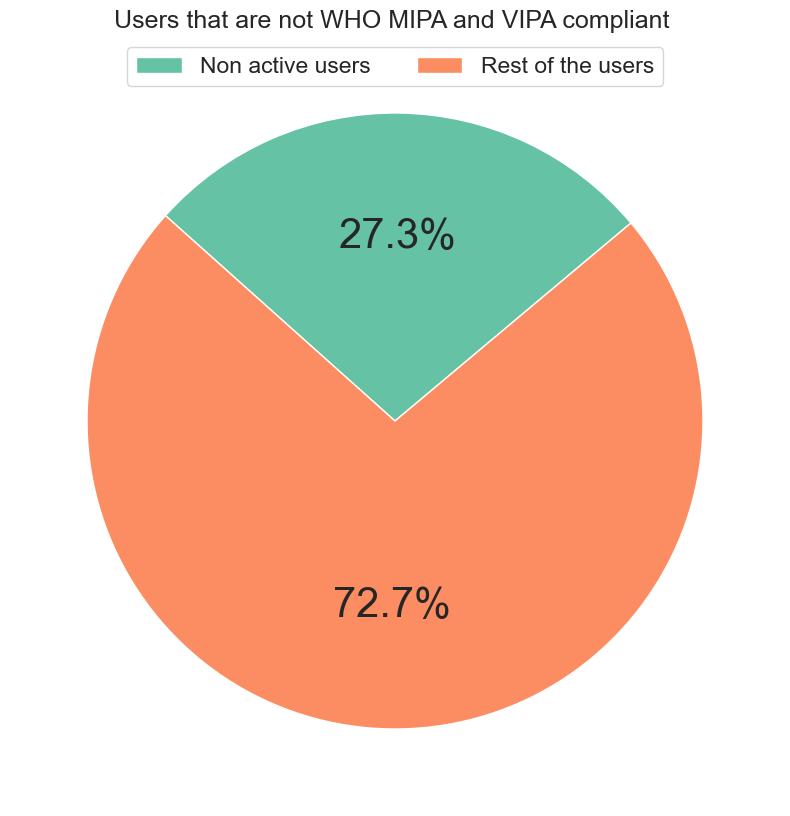

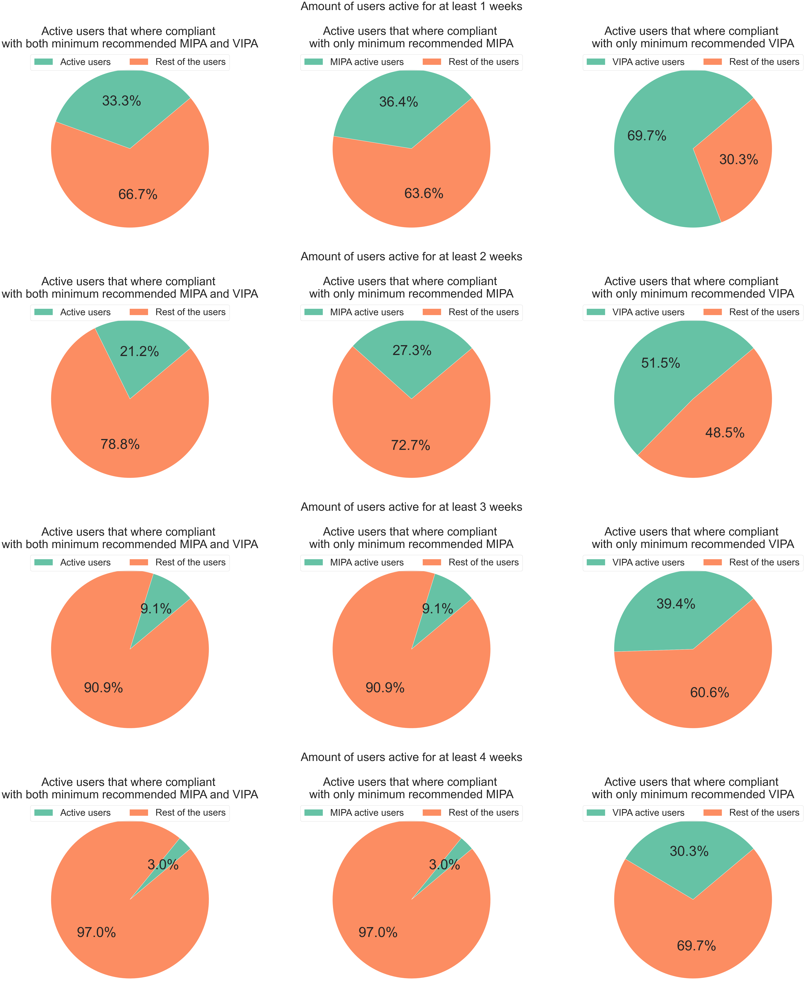

In [23]:
# Most active user
most_active_users = df_activity_grouped_week.groupby('Id').agg({'WHO_MIPA_Compliant': 'sum', 'WHO_VIPA_Compliant': 'sum'}).sort_values(by=['WHO_MIPA_Compliant', 'WHO_VIPA_Compliant'], ascending=False)

# Least active user
least_active_users = df_activity_grouped_week.groupby('Id').agg({'WHO_MIPA_Compliant': 'sum', 'WHO_VIPA_Compliant': 'sum'}).sort_values(by=['WHO_MIPA_Compliant', 'WHO_VIPA_Compliant'], ascending=True)

active_weeks = np.arange(1, len(df_activity['Week'].unique())+1)

non_active_users_count = least_active_users[(least_active_users['WHO_MIPA_Compliant'] == 0) & (least_active_users['WHO_VIPA_Compliant'] == 0)].shape[0]
print(f"Non active users: {non_active_users_count} ({round(non_active_users_count/least_active_users.shape[0]*100, 2)}%)\n")
whole_count = most_active_users.shape[0]
print(f"Total number of users: {whole_count}\n")
print(f"Non active users count: {non_active_users_count}")

fig, ax = plt.subplots(figsize=(25, 10))
ax.pie([non_active_users_count, whole_count-non_active_users_count], autopct='%1.1f%%', startangle=40, \
        textprops={'fontsize': 30}, pctdistance=0.6, labeldistance=.6, colors=sns.color_palette("Set2"))
ax.legend(['Non active users', 'Rest of the users'], loc="upper center", ncol=2)
ax.set_title(f'Users that are not WHO MIPA and VIPA compliant ', ha='center')
fig.savefig('figures/non_active_users.png')
fig, ax = plt.subplots(figsize=(50, 60), ncols=3, nrows=4)
active_weeks = active_weeks[:len(active_weeks)-1]
subplt_title_size = 50
text_prompts_size = 60
label_size = 40
for i, week in enumerate(active_weeks):
    full_active_users_count = most_active_users[(most_active_users['WHO_MIPA_Compliant'] >= week) & (most_active_users['WHO_VIPA_Compliant'] >= week)].shape[0]
    mipa_active_users_count = most_active_users[(most_active_users['WHO_MIPA_Compliant'] >= week)].shape[0]
    vipa_active_users_count = most_active_users[(most_active_users['WHO_VIPA_Compliant'] >= week)].shape[0]
    print(f"Users that were MIPA active for at least {week} weeks: {mipa_active_users_count} ({round(mipa_active_users_count/most_active_users.shape[0]*100, 2)}%)")
    print(f"Users that were VIPA active for at least {week} weeks: {vipa_active_users_count} ({round(vipa_active_users_count/most_active_users.shape[0]*100, 2)}%)")
    print(f"Users that were active for at least {week} weeks: {full_active_users_count} ({round(full_active_users_count/most_active_users.shape[0]*100, 2)}%)\n")
    
    # Plotting the number of active users over the weeks
    # fig, ax = plt.subplots(figsize=(25, 10), ncols=3, nrows=1)
    # fig.suptitle(f'Amount of users active for at least {week} weeks', fontsize=20)

    ax[i][0].pie([full_active_users_count, whole_count-full_active_users_count], autopct='%1.1f%%', startangle=40, \
        pctdistance=0.6, labeldistance=.6, textprops={'fontsize': text_prompts_size}, colors=sns.color_palette("Set2"))
    ax[i][0].legend(['Active users', 'Rest of the users'], loc="upper center", ncol=2, fontsize=label_size)
    ax[i][0].set_title(f'\n\nActive users that where compliant \nwith both minimum recommended MIPA and VIPA', ha='center', fontsize=subplt_title_size)

    ax[i][1].pie([mipa_active_users_count, whole_count-mipa_active_users_count], autopct='%1.1f%%', startangle=40,\
         pctdistance=0.6, labeldistance=.6, textprops={'fontsize': text_prompts_size}, colors=sns.color_palette("Set2"))
    ax[i][1].legend(['MIPA active users', 'Rest of the users'], loc="upper center", ncol=2, fontsize=label_size)
    ax[i][1].set_title(f'Amount of users active for at least {week} weeks\n\nActive users that where compliant \nwith only minimum recommended MIPA', ha='center', fontsize=subplt_title_size)

    ax[i][2].pie([vipa_active_users_count, whole_count-vipa_active_users_count], autopct='%1.1f%%', startangle=40, \
        textprops={'fontsize': text_prompts_size}, pctdistance=0.6, labeldistance=.6, colors=sns.color_palette("Set2"))
    ax[i][2].legend(['VIPA active users', 'Rest of the users'], loc="upper center", ncol=2, fontsize=label_size)
    ax[i][2].set_title(f'\n\nActive users that where compliant \nwith only minimum recommended VIPA', ha='center', fontsize=subplt_title_size) 
plt.tight_layout()
fig.savefig(f'figures/active_users_over_{week}_weeks.png') 
    

In [24]:
x = df_activity_grouped_week.groupby('Id').agg({'WHO_MIPA_Compliant': 'sum', 'WHO_VIPA_Compliant': 'sum'}).sort_values(by=['WHO_MIPA_Compliant', 'WHO_VIPA_Compliant'], ascending=False)
tot = x.shape[0]
print(x[x['WHO_MIPA_Compliant']>=1].shape[0]/ tot)
print(x[x['WHO_MIPA_Compliant']>=2].shape[0]/ tot)
print(x[x['WHO_MIPA_Compliant']>=3].shape[0]/ tot)
print(x[x['WHO_MIPA_Compliant']>=4].shape[0]/ tot)


0.36363636363636365
0.2727272727272727
0.09090909090909091
0.030303030303030304


,WHO_MIPA_Compliant,WHO_VIPA_Compliant,WHO_MIPA+VIPA_Score
Id,,,
5577150313,3,5,8
7086361926,3,5,8
2022484408,2,5,7


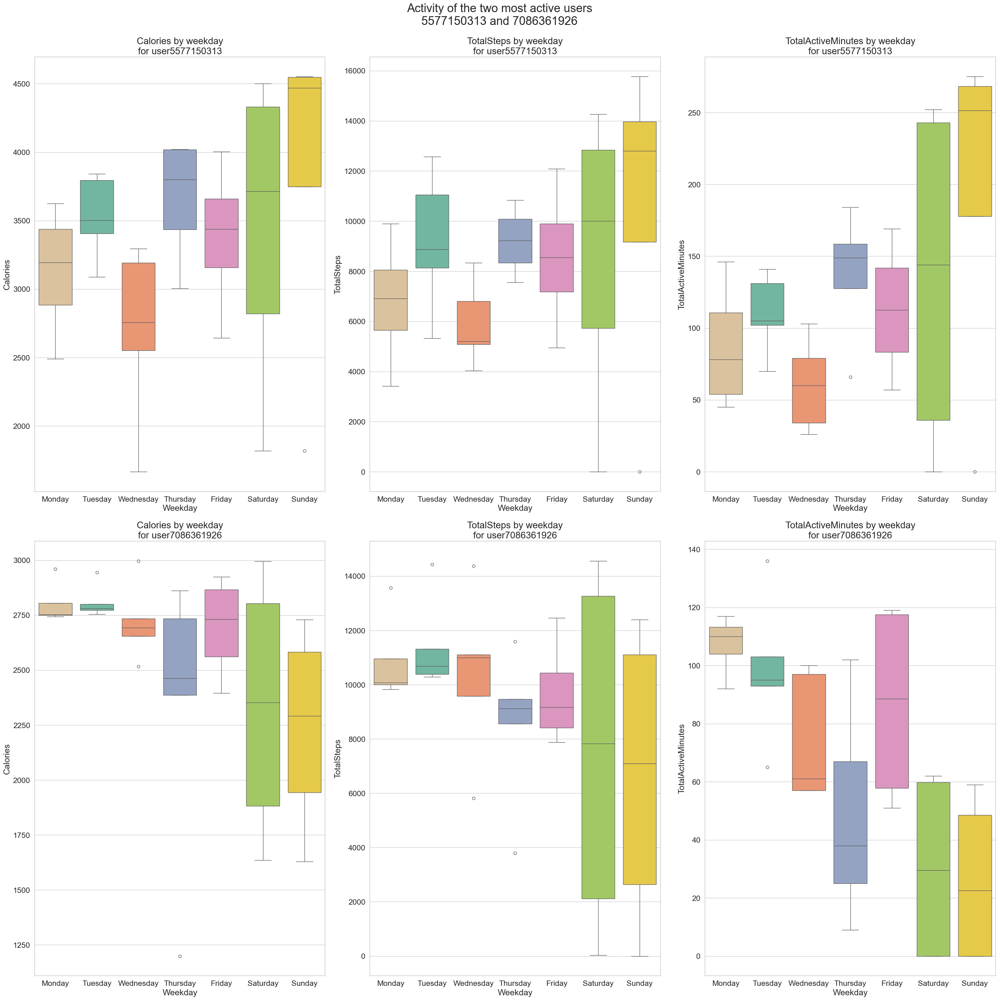

In [25]:
most_active_users = most_active_users.sort_values(by=['WHO_VIPA_Compliant', 'WHO_MIPA_Compliant'], ascending=False)
most_active_users['WHO_MIPA+VIPA_Score'] = most_active_users['WHO_MIPA_Compliant'] + most_active_users['WHO_VIPA_Compliant']
display(most_active_users.head(3))
ids = most_active_users.head(3).index.unique()
df_most_actives = df_activity[(df_activity['Id'] == ids[0]) | (df_activity['Id'] == ids[1])]

# display(df_most_active)
fig, ax = plt.subplots(figsize=(30, 30), ncols=3, nrows=2)
plt.suptitle(f'Activity of the two most active users\n{ids[0]} and {ids[1]}', fontsize=25, va='center')
for i, df_most_active in enumerate(df_most_actives.groupby('Id')):
    ax[i][0].set_title(f'Calories by weekday\nfor user{df_most_active[0]}', fontsize=20)
    sns.boxplot(x='Weekday', y='Calories', data=df_most_active[1], hue='Weekday', order=days_ord, palette='Set2', ax=ax[i][0])
    ax[i][1].set_title(f'TotalSteps by weekday\nfor user{df_most_active[0]}', fontsize=20)
    sns.boxplot(x='Weekday', y='TotalSteps', data=df_most_active[1], hue='Weekday', order=days_ord, palette='Set2', ax=ax[i][1])
    ax[i][2].set_title(f'TotalActiveMinutes by weekday\nfor user{df_most_active[0]}', fontsize=20)
    sns.boxplot(x='Weekday', y='TotalActiveMinutes', data=df_most_active[1], hue='Weekday', order=days_ord, palette='Set2', ax=ax[i][2])
plt.tight_layout()

# Preliminary analysis on Sleep dataset

In [26]:
def sleep_mapping(x):
    x = x/60
    if x < 7:
        return 'Inadequate'
    elif x >= 7 and x < 10:
        return 'Adequate'
    else:
        return 'Oversleep'


df_sleep = dataset['sleepDay'].copy(deep=True)
df_sleep['SleepDay'] = pd.to_datetime(df_sleep['SleepDay'], format='%m/%d/%Y %I:%M:%S %p')
df_sleep.drop(columns=['TotalSleepRecords'], inplace=True)
df_sleep.rename(columns={'SleepDay': 'Date'}, inplace=True)
df_sleep.drop_duplicates(inplace=True)
df_sleep['SleepEfficiency'] = df_sleep['TotalMinutesAsleep'] / df_sleep['TotalTimeInBed']
df_sleep['HoursSlept'] = df_sleep['TotalMinutesAsleep'] / 60.0
df_sleep['Type'] = df_sleep.apply(lambda x: sleep_mapping(x['TotalMinutesAsleep']), axis=1)
df_sleep['Weekday'] = df_sleep['Date'].dt.day_name()
df_sleep.rename(columns={'Type': 'SleepType'}, inplace=True)
display(df_sleep)
max_days = 31
lower_bound = 7
print(f"Sleep dataframe rows before removing users with less than {lower_bound} records: {df_sleep.shape[0]}\n")
for el in df_sleep.groupby('Id'):
    print(f"User: {el[0]}, records available: {el[1].shape[0]}")
    if el[1].shape[0] < lower_bound:
        print("removing data of user: ", el[0])
        df_sleep.drop(df_sleep[df_sleep['Id'] == el[0]].index, inplace=True)
print(f"Sleep dataframe rows after removing users with less than {lower_bound} records: {df_sleep.shape[0]}")

print(f"Average number of hours slept per night: {round(df_sleep['HoursSlept'].mean(), 2)}")

,Id,Date,TotalMinutesAsleep,TotalTimeInBed,SleepEfficiency,HoursSlept,SleepType,Weekday
0,1503960366,2016-04-12,327,346,0.945087,5.450000,Inadequate,Tuesday
1,1503960366,2016-04-13,384,407,0.943489,6.400000,Inadequate,Wednesday
2,1503960366,2016-04-15,412,442,0.932127,6.866667,Inadequate,Friday
3,1503960366,2016-04-16,340,367,0.926431,5.666667,Inadequate,Saturday
4,1503960366,2016-04-17,700,712,0.983146,11.666667,Oversleep,Sunday
...,...,...,...,...,...,...,...,...
408,8792009665,2016-04-30,343,360,0.952778,5.716667,Inadequate,Saturday
409,8792009665,2016-05-01,503,527,0.954459,8.383333,Adequate,Sunday
410,8792009665,2016-05-02,415,423,0.981087,6.916667,Inadequate,Monday
411,8792009665,2016-05-03,516,545,0.946789,8.600000,Adequate,Tuesday


Sleep dataframe rows before removing users with less than 7 records: 410

User: 1503960366, records available: 25
User: 1644430081, records available: 4
removing data of user:  1644430081
User: 1844505072, records available: 3
removing data of user:  1844505072
User: 1927972279, records available: 5
removing data of user:  1927972279
User: 2026352035, records available: 28
User: 2320127002, records available: 1
removing data of user:  2320127002
User: 2347167796, records available: 15
User: 3977333714, records available: 28
User: 4020332650, records available: 8
User: 4319703577, records available: 26
User: 4388161847, records available: 23
User: 4445114986, records available: 28
User: 4558609924, records available: 5
removing data of user:  4558609924
User: 4702921684, records available: 27
User: 5553957443, records available: 31
User: 5577150313, records available: 26
User: 6117666160, records available: 18
User: 6775888955, records available: 3
removing data of user:  6775888955
Use

In [27]:
df_sleep.describe()

,Id,Date,TotalMinutesAsleep,TotalTimeInBed,SleepEfficiency,HoursSlept
count,3.840000e+02,384,384.000000,384.000000,384.000000,384.000000
mean,5.058768e+09,2016-04-26 14:56:15,426.739583,465.098958,0.917547,7.112326
min,1.503960e+09,2016-04-12 00:00:00,59.000000,65.000000,0.498361,0.983333
25%,4.009583e+09,2016-04-19 00:00:00,370.000000,409.750000,0.912645,6.166667
50%,4.702922e+09,2016-04-27 00:00:00,436.000000,467.000000,0.943184,7.266667
75%,6.962181e+09,2016-05-04 00:00:00,492.000000,527.750000,0.960695,8.200000
max,8.792010e+09,2016-05-12 00:00:00,775.000000,843.000000,1.000000,12.916667
std,2.018209e+09,NaN,102.241254,101.502579,0.086878,1.704021


/var/folders/97/yjfp60y90vvgjz812_bx179m0000gn/T/ipykernel_91399/151442820.py:4: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




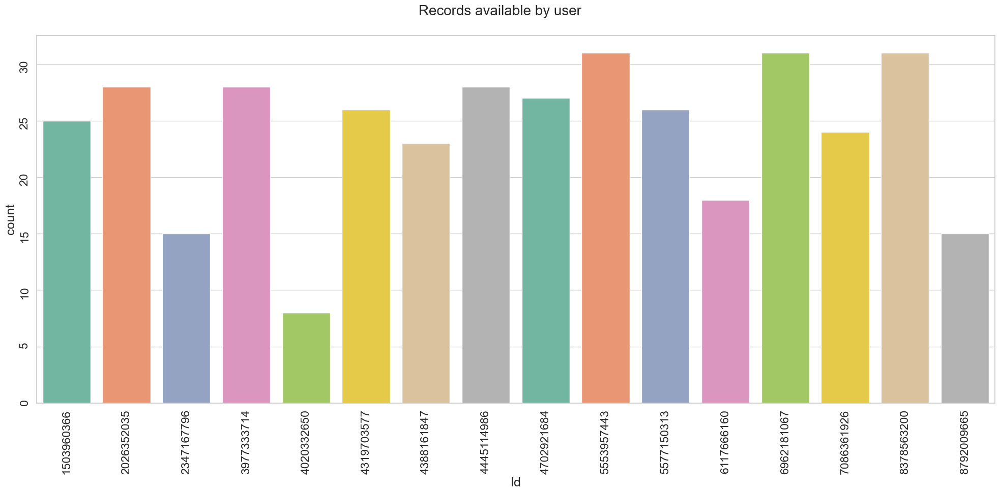

In [28]:
sleep_grouped = df_sleep.groupby('Id')
fig, ax = plt.subplots(figsize=(20, 10))
plt.suptitle('Records available by user', fontsize=20)
sns.countplot(data=df_sleep, x='Id', palette='Set2', ax=ax)
plt.tick_params(rotation=90)
plt.tight_layout()
fig.savefig('figures/sleep_records_by_user.png')


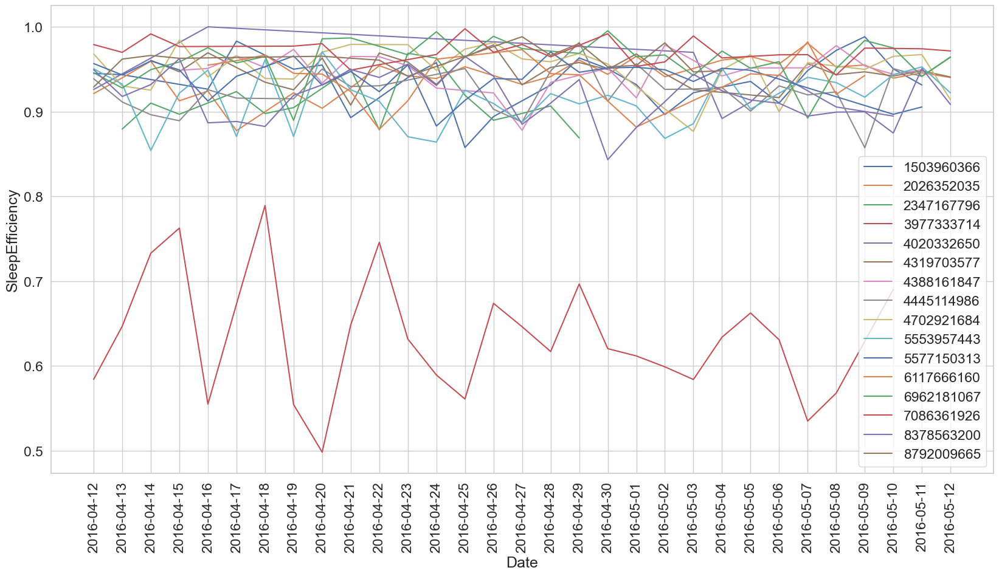

In [29]:
fig = plt.figure(figsize=(20, 10))
all_dates = df_sleep['Date'].unique() 
for i in sleep_grouped:
    ax = sns.lineplot(data=i[1], x='Date', y='SleepEfficiency', label=i[0])
    ax.set_xticks(all_dates)
    plt.xticks(rotation=90)
fig.savefig('figures/sleep_efficiency_by_user.png')

In [30]:
scatt = px.scatter(df_sleep, x='TotalMinutesAsleep', y='TotalTimeInBed', trendline='ols', size='SleepEfficiency',title='TotalMinutesAsleep vs TotalTimeInBed based on SleepEfficiency')
scatt.show()
# scatt.write_image('figures/sleep_efficiency_trendline.png', scale=3)

Except for user 7086361926, the other users shows a good sleep efficiency > 85%

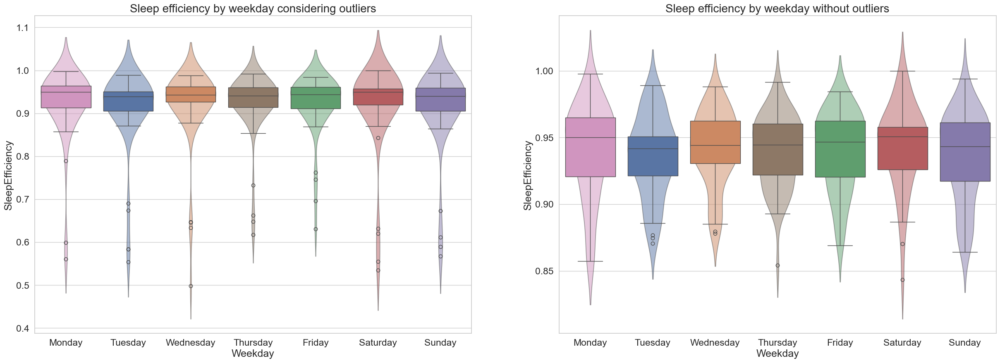

<Figure size 2000x1000 with 0 Axes>

In [31]:
fig, ax = plt.subplots(figsize=(30, 10), ncols=2, nrows=1)
plt.figure(figsize=(20,10))
ax[0].set_title('Sleep efficiency by weekday considering outliers', fontsize=20)
sns.boxplot(data=df_sleep, x='Weekday', y='SleepEfficiency', order=days_ord, hue='Weekday', ax=ax[0])
sns.violinplot(data=df_sleep, x='Weekday', y='SleepEfficiency', order=days_ord, hue='Weekday',alpha=0.5, inner=None, ax=ax[0])

# Removing outliers
Q1 = df_sleep['SleepEfficiency'].quantile(0.25)
Q3 = df_sleep['SleepEfficiency'].quantile(0.75)
IQR = Q3 - Q1
sleep_outliers = (df_sleep['SleepEfficiency'] < (Q1 - 1.5 * IQR)) | (df_sleep['SleepEfficiency'] > (Q3 + 1.5 * IQR))
df_sleep = df_sleep[~sleep_outliers]
ax[1].set_title('Sleep efficiency by weekday without outliers', fontsize=20)
sns.boxplot(data=df_sleep, x='Weekday', y='SleepEfficiency', order=days_ord, hue='Weekday', ax=ax[1])
sns.violinplot(data=df_sleep, x='Weekday', y='SleepEfficiency', order=days_ord, inner=None, hue='Weekday', alpha=0.5, ax=ax[1])
fig.savefig('figures/sleep_efficiency_by_weekday.png')
plt.tight_layout()


In [32]:
df_sleep.shape

(356, 8)

<Figure size 2000x1000 with 0 Axes>

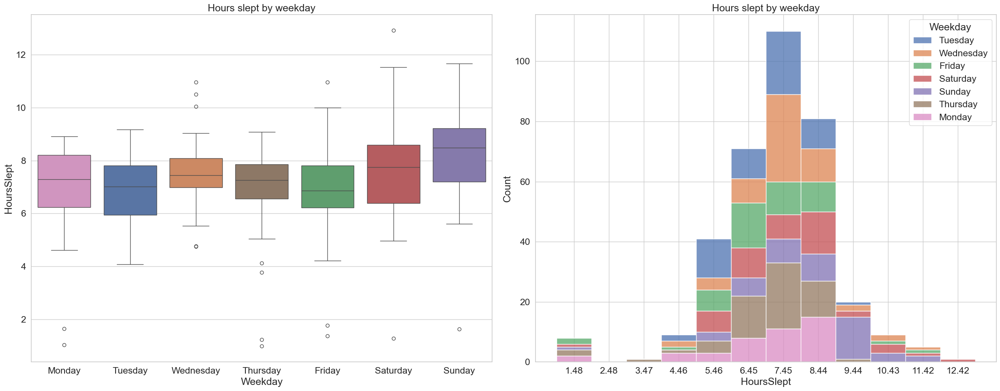

In [33]:
plt.figure(figsize=(20,10))
fig, ax = plt.subplots(figsize=(25, 10), ncols=2, nrows=1)
sns.boxplot(data=df_sleep, x='Weekday', y='HoursSlept', hue='Weekday', order=days_ord, ax=ax[0]).set_title('Hours slept by weekday')
avg_sleep_weekday = df_sleep.groupby('Weekday').agg({'HoursSlept': 'mean'}).sort_values(by='HoursSlept', ascending=False)
sns.histplot(data=df_sleep, x='HoursSlept', hue='Weekday', multiple='stack', ax=ax[1], bins=12).set_title('Hours slept by weekday')
# Get the binwidth
binwidth = (df_sleep['HoursSlept'].max() - df_sleep['HoursSlept'].min()) / 12

# Set the x-axis tick positions to align with bin centers
xtick_positions = [df_sleep['HoursSlept'].min() + i * binwidth + binwidth / 2 for i in range(12)]
ax[1].set_xticks(xtick_positions)
plt.tight_layout()
fig.savefig('figures/sleep_hours_by_weekday.png')

In [34]:
# # display(df_sleep)
# print(df_sleep.columns)
# sleep_pivot = pd.pivot_table(df_sleep, index='Date', columns='Type', values='HoursSlept')
# sleep_pivot.index = sleep_pivot.index.astype('str')
# fig, ax = plt.subplots(figsize=(20, 20))
# sns.heatmap(sleep_pivot, annot=True, cmap='Blues')

,Id,HoursSlept,SleepEfficiency,SleepScore
11,6962181067,231.466667,0.961487,222.552248
1,2026352035,236.216667,0.941341,222.360523
8,5553957443,239.466667,0.915207,219.161633
13,8378563200,229.983333,0.917508,211.011629
4,4319703577,206.550000,0.947497,195.705606


User 6962181067 is considered the most sleepy based on sleep score 222.55
Datapoints available: 31
7.466666666666667


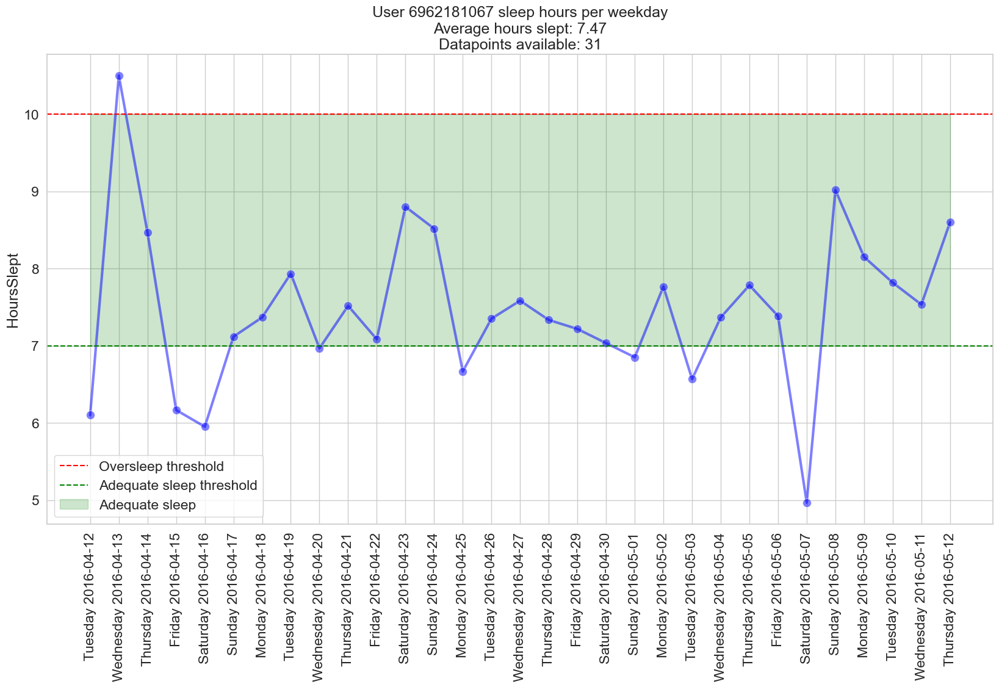

In [35]:
sleep_grouped = df_sleep.groupby('Id')
sleep_grouped = sleep_grouped.agg({'HoursSlept': 'sum', 'SleepEfficiency': 'mean'})
sleep_grouped.reset_index(inplace=True)
sleep_grouped['SleepScore'] = sleep_grouped['HoursSlept'] * sleep_grouped['SleepEfficiency']
sleep_grouped.sort_values(by='SleepScore', ascending=False, inplace=True)

sleepy_user_id, sleep_score = sleep_grouped.head(1)[['Id', 'SleepScore']].values[0]
sleepy_user_id = int(sleepy_user_id)
fig = plt.figure(figsize=(20,10))
# sns.boxplot(data=df_sleep[df_sleep['Id'] == sleepy_user_id], x='Weekday', y='HoursSlept', hue='Weekday', order=days_ord).set_title(f'User {sleepy_user_id} sleep hours per weekday')
display(sleep_grouped.head(5))
datapoints = df_sleep[df_sleep['Id']==sleepy_user_id].shape[0]
print(f"User {sleepy_user_id} is considered the most sleepy based on sleep score {round(sleep_score,2)}\nDatapoints available: {datapoints}")

dff = df_sleep[df_sleep['Id'] == sleepy_user_id]
weekdays = dff['Date'].dt.day_name()
dates = []
for w, d in zip(weekdays, dff['Date']):
    dates.append(w + ' ' + str(d.date()))
sns.lineplot(data=dff, x=dates, y='HoursSlept', markers=True, marker='o', color='blue',alpha=0.5, linewidth=3, markersize=10)\
    .set_title(f'User {sleepy_user_id} sleep hours per weekday\nAverage hours slept: {round(dff["HoursSlept"].mean(), 2)}\nDatapoints available: {datapoints}')
plt.axhline(y=10, color='red', linestyle='--', label='Oversleep threshold')
plt.axhline(y=7, color='green', linestyle='--', label='Adequate sleep threshold')
plt.fill_between(dates, 7, 10, color='green', alpha=0.2, label='Adequate sleep')
plt.legend()
plt.xticks(rotation=90)
fig.savefig('figures/second_least_sleepy_user.png', bbox_inches='tight')
print(dff['HoursSlept'].mean())

,Id,HoursSlept,SleepEfficiency,SleepScore
2,2347167796,111.700000,0.910370,101.688370
3,4020332650,46.583333,0.930358,43.339157


User 2347167796 is considered the most sleepy based on sleep score 101.69


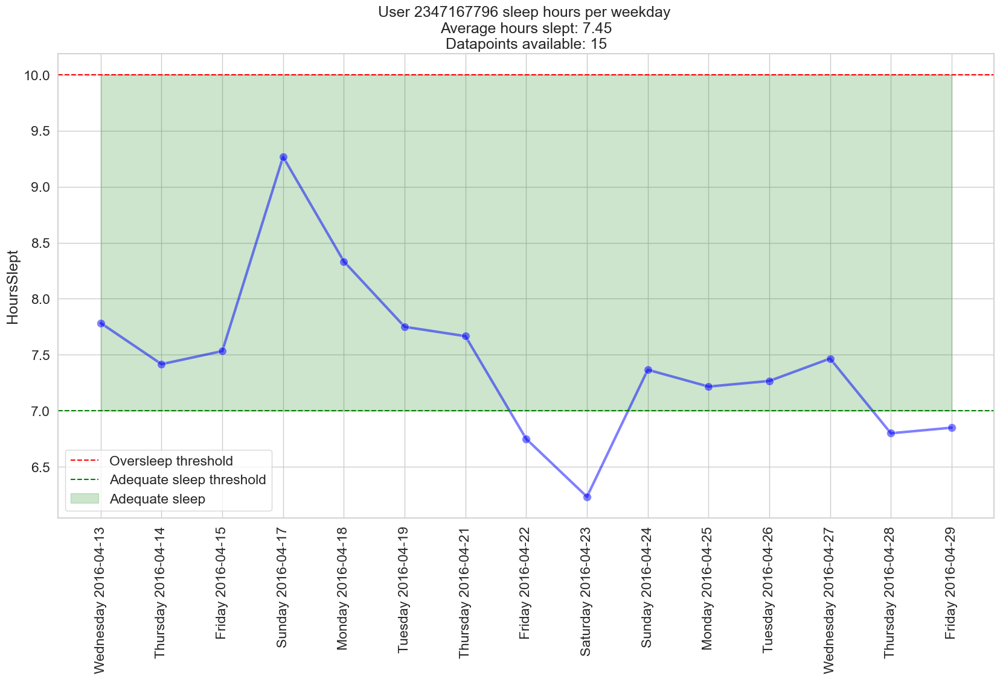

In [36]:
sleepy_user_id, sleep_score = sleep_grouped.tail(2)[['Id', 'SleepScore']].values[0]
sleepy_user_id = int(sleepy_user_id)
fig = plt.figure(figsize=(20,10))
# sns.boxplot(data=df_sleep[df_sleep['Id'] == sleepy_user_id], x='Weekday', y='HoursSlept', hue='Weekday', order=days_ord).set_title(f'User {sleepy_user_id} sleep hours per weekday')
display(sleep_grouped.tail(2))

print(f"User {sleepy_user_id} is considered the most sleepy based on sleep score {round(sleep_score,2)}")
datapoints = df_sleep[df_sleep['Id']==sleepy_user_id].shape[0]
dff = df_sleep[df_sleep['Id'] == sleepy_user_id]
weekdays = dff['Date'].dt.day_name()
dates = []
for w, d in zip(weekdays, dff['Date']):
    dates.append(w + ' ' + str(d.date()))
sns.lineplot(data=dff, x=dates, y='HoursSlept', markers=True, marker='o', color='blue',alpha=0.5, linewidth=3, markersize=10)\
    .set_title(f'User {sleepy_user_id} sleep hours per weekday \nAverage hours slept: {round(dff["HoursSlept"].mean(), 2)}\nDatapoints available: {datapoints}')
plt.axhline(y=10, color='red', linestyle='--', label='Oversleep threshold')
plt.axhline(y=7, color='green', linestyle='--', label='Adequate sleep threshold')
plt.fill_between(dates, 7, 10, color='green', alpha=0.2, label='Adequate sleep')
plt.legend()
plt.xticks(rotation=90)
fig.savefig('figures/less_sleepy_user.png', bbox_inches='tight')

,Id,HoursSlept,SleepEfficiency,SleepScore
2,2347167796,111.700000,0.910370,101.688370
3,4020332650,46.583333,0.930358,43.339157


User 4020332650 is considered the most sleepy based on sleep score 43.34


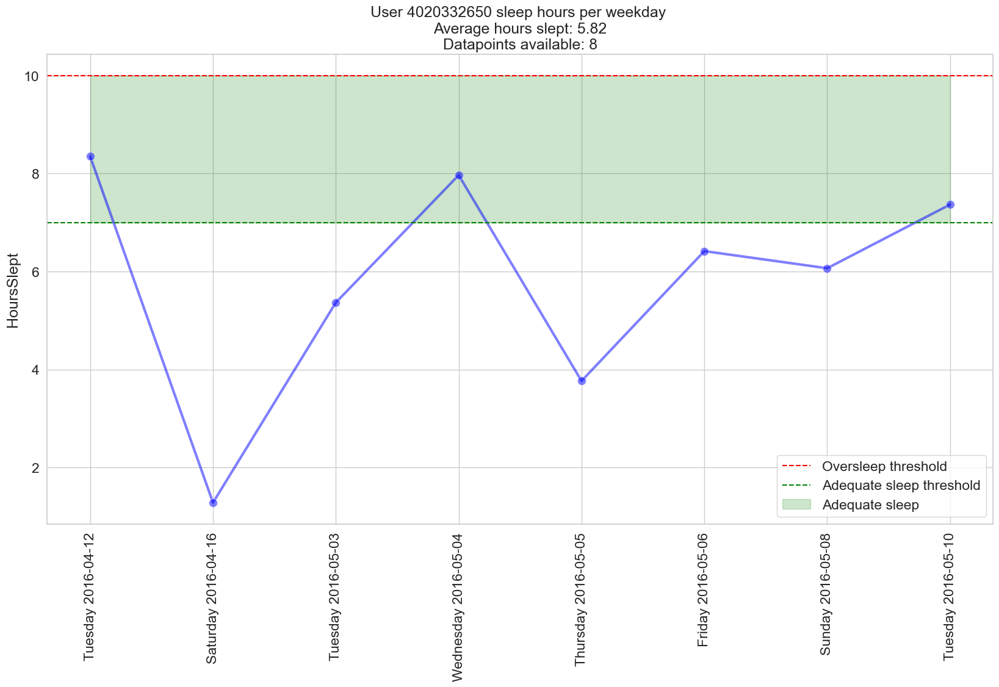

In [37]:
sleepy_user_id, sleep_score = sleep_grouped.tail(1)[['Id', 'SleepScore']].values[0]
sleepy_user_id = int(sleepy_user_id)
fig = plt.figure(figsize=(20,10))
display(sleep_grouped.tail(2))

print(f"User {sleepy_user_id} is considered the most sleepy based on sleep score {round(sleep_score,2)}")

dff = df_sleep[df_sleep['Id'] == sleepy_user_id]
datapoints = df_sleep[df_sleep['Id']==sleepy_user_id].shape[0]
weekdays = dff['Date'].dt.day_name()
dates = []
for w, d in zip(weekdays, dff['Date']):
    dates.append(w + ' ' + str(d.date()))
sns.lineplot(data=dff, x=dates, y='HoursSlept', markers=True, marker='o', color='blue',alpha=0.5, linewidth=3, markersize=10)\
    .set_title(f'User {sleepy_user_id} sleep hours per weekday \nAverage hours slept: {round(dff["HoursSlept"].mean(), 2)}\nDatapoints available: {datapoints}')
plt.axhline(y=10, color='red', linestyle='--', label='Oversleep threshold')
plt.axhline(y=7, color='green', linestyle='--', label='Adequate sleep threshold')
plt.fill_between(dates, 7, 10, color='green', alpha=0.2, label='Adequate sleep')
plt.legend()
plt.xticks(rotation=90)
fig.savefig('figures/less_sleepy_user2.png', bbox_inches='tight')

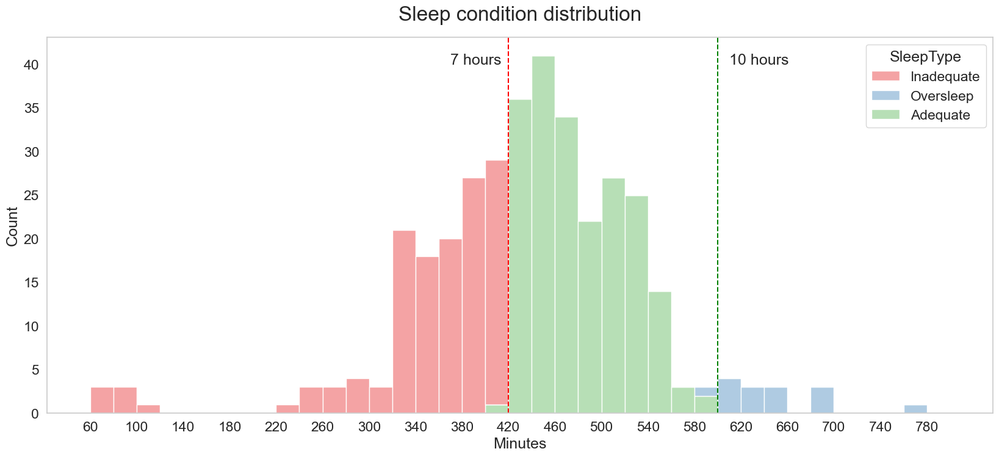

In [38]:
# plot sleep condition distribution
fig, ax = plt.subplots(figsize=(20,8))
sns.histplot(ax=ax, data=df_sleep, x="TotalMinutesAsleep", hue="SleepType", palette='Set1', multiple="stack", alpha=0.4, bins=40, binwidth=20, binrange=(60.00001,800))
ax.axvline(x=420, color='red', linestyle='--')
ax.axvline(x=600, color='green', linestyle='--')
ax.text(370,40, "7 hours")
ax.text(610,40, "10 hours")
ax.set_title("Sleep condition distribution", fontsize=24, pad=20)
ax.set_xlabel("Minutes")

ax.set_xticks(range(60,800, 40))
ax.grid(False)
plt.show()
fig.savefig('figures/sleep_condition_distribution.png')

In [39]:
df_sleep.query('SleepType == "Oversleep"')['TotalMinutesAsleep']

4      700
125    692
138    602
145    619
232    651
236    658
239    631
246    775
247    622
281    603
296    600
299    658
307    630
347    681
370    611
Name: TotalMinutesAsleep, dtype: int64

In [40]:
df_sleep['SleepScore'] = df_sleep['HoursSlept'] * df_sleep['SleepEfficiency']

# Merging the two datasets

In [41]:
print("Activities dataset rows: ",df_activity.shape[0])
print("Sleep dataset rows: ",df_sleep.shape[0])
df_activity.rename(columns={'Type': 'ActivityType'}, inplace=True)
df_merged = df_activity.merge(df_sleep.drop(columns=['Weekday']), how='inner', on=['Id', 'Date'])
print("Rows after merging ",df_merged.shape[0])

Activities dataset rows:  925
Sleep dataset rows:  356
Rows after merging  353


In [42]:
print("Original Activity dataframe statistics")
display(df_activity.describe())
print("Statistics after mergining it with the sleep dataframe")
display(df_merged.describe())

Original Activity dataframe statistics


,Date,Id,TotalSteps,TotalDistance,TrackerDistance,VeryActiveDistance,ModeratelyActiveDistance,LightActiveDistance,SedentaryActiveDistance,VeryActiveMinutes,ModeratelyActiveMinutes,LightlyActiveMinutes,SedentaryMinutes,Calories,TotalActiveMinutes,TotalActiveHours,TotalTrackedMinutes,TotalTrackedHours,Week
count,925,9.250000e+02,925.000000,925.000000,925.000000,925.000000,925.000000,925.000000,925.000000,925.000000,925.000000,925.000000,925.000000,925.000000,925.000000,925.000000,925.000000,925.000000,925.0
mean,2016-04-26 07:43:54.810810624,4.820652e+09,7529.765405,5.408281,5.408281,1.459697,0.558497,3.310378,0.001384,20.680000,13.415135,190.991351,991.625946,2296.445405,34.095135,0.568252,1216.712432,20.278541,16.768649
min,2016-04-12 00:00:00,1.503960e+09,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000,0.033333,15.0
25%,2016-04-19 00:00:00,2.320127e+09,3758.000000,2.600000,2.600000,0.000000,0.000000,1.910000,0.000000,0.000000,0.000000,125.000000,729.000000,1821.000000,0.000000,0.000000,989.000000,16.483333,16.0
50%,2016-04-26 00:00:00,4.445115e+09,7328.000000,5.180000,5.180000,0.190000,0.230000,3.310000,0.000000,3.000000,6.000000,196.000000,1061.000000,2124.000000,18.000000,0.300000,1440.000000,24.000000,17.0
75%,2016-05-04 00:00:00,6.962181e+09,10602.000000,7.570000,7.570000,1.940000,0.790000,4.730000,0.000000,30.000000,19.000000,262.000000,1234.000000,2782.000000,57.000000,0.950000,1440.000000,24.000000,18.0
max,2016-05-12 00:00:00,8.877689e+09,36019.000000,28.030001,28.030001,21.920000,6.480000,10.710000,0.070000,210.000000,143.000000,518.000000,1440.000000,4900.000000,275.000000,4.583333,1440.000000,24.000000,19.0
std,NaN,2.428857e+09,5048.079415,3.898302,3.898302,2.657874,0.884520,2.036994,0.005586,32.870783,20.075630,108.923252,302.966899,720.542291,43.482937,0.724716,266.475703,4.441262,1.286161


Statistics after mergining it with the sleep dataframe


,Date,Id,TotalSteps,TotalDistance,TrackerDistance,VeryActiveDistance,ModeratelyActiveDistance,LightActiveDistance,SedentaryActiveDistance,VeryActiveMinutes,ModeratelyActiveMinutes,LightlyActiveMinutes,SedentaryMinutes,Calories,TotalActiveMinutes,TotalActiveHours,TotalTrackedMinutes,TotalTrackedHours,Week,TotalMinutesAsleep,TotalTimeInBed,SleepEfficiency,HoursSlept,SleepScore
count,353,3.530000e+02,353.000000,353.000000,353.000000,353.000000,353.000000,353.000000,353.000000,353.000000,353.000000,353.000000,353.000000,353.000000,353.000000,353.000000,353.000000,353.000000,353.0,353.000000,353.000000,353.000000,353.000000,353.000000
mean,2016-04-26 16:39:26.005665792,5.128371e+09,8402.558074,5.941785,5.941785,1.398924,0.597365,3.910963,0.000482,25.801700,14.906516,221.949008,697.124646,2455.719547,40.708215,0.678470,959.781870,15.996364,16.818697,437.127479,465.487252,0.939549,7.285458,6.848606
min,2016-04-12 00:00:00,1.503960e+09,17.000000,0.010000,0.010000,0.000000,0.000000,0.010000,0.000000,0.000000,0.000000,2.000000,0.000000,257.000000,0.000000,0.000000,2.000000,0.033333,15.0,59.000000,65.000000,0.843243,0.983333,0.892564
25%,2016-04-19 00:00:00,4.319704e+09,5232.000000,3.600000,3.600000,0.000000,0.000000,2.630000,0.000000,0.000000,0.000000,161.000000,623.000000,1933.000000,0.000000,0.000000,905.000000,15.083333,16.0,385.000000,410.000000,0.921965,6.416667,6.016946
50%,2016-04-27 00:00:00,4.702922e+09,8793.000000,6.260000,6.260000,0.560000,0.390000,3.900000,0.000000,8.000000,10.000000,215.000000,716.000000,2266.000000,27.000000,0.450000,981.000000,16.350000,17.0,441.000000,467.000000,0.944712,7.350000,6.927801
75%,2016-05-04 00:00:00,6.962181e+09,10988.000000,7.830000,7.830000,2.370000,0.890000,5.200000,0.000000,39.000000,23.000000,270.000000,774.000000,2982.000000,62.000000,1.033333,1037.000000,17.283333,18.0,499.000000,531.000000,0.961957,8.316667,7.826243
max,2016-05-12 00:00:00,8.792010e+09,22770.000000,17.540001,17.540001,9.890000,5.120000,9.480000,0.070000,210.000000,95.000000,518.000000,1265.000000,4900.000000,275.000000,4.583333,1363.000000,22.716667,19.0,775.000000,843.000000,1.000000,12.916667,11.874753
std,NaN,2.074396e+09,3998.833413,2.923381,2.923381,1.846919,0.715653,1.727924,0.005062,37.348638,16.796401,87.465790,155.913351,764.547276,48.249910,0.804165,158.989889,2.649831,1.288494,97.614549,103.789207,0.030057,1.626909,1.563394


7529.7654054054055 8402.55807365439
5.408281074377733 5.941784713174568
2296.4454054054054 2455.71954674221
34.09513513513514 40.70821529745042
991.625945945946 697.1246458923513


/var/folders/97/yjfp60y90vvgjz812_bx179m0000gn/T/ipykernel_91399/3230986803.py:11: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/var/folders/97/yjfp60y90vvgjz812_bx179m0000gn/T/ipykernel_91399/3230986803.py:11: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/var/folders/97/yjfp60y90vvgjz812_bx179m0000gn/T/ipykernel_91399/3230986803.py:11: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/var/folders/97/yjfp60y90vvgjz812_bx179m0000gn/T/ipykernel_91399/3230986803.py:11: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign 

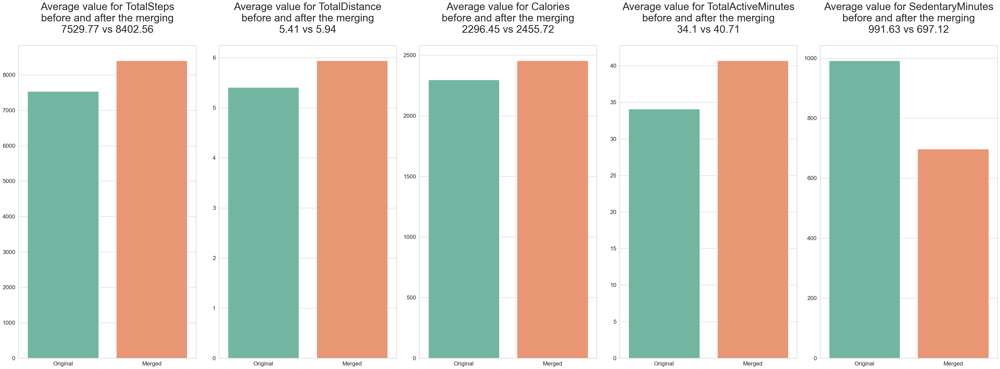

In [43]:
cols = ['TotalSteps', 'TotalDistance', 'Calories', 'TotalActiveMinutes', 'SedentaryMinutes']
df_a = df_activity[cols]
df_b = df_merged[cols]

df_a = df_a.mean()
df_b = df_b.mean()
fig, ax = plt.subplots(figsize=(40, 15), ncols=5, nrows=1)
for i,c in enumerate(cols):
    print(df_a[c], df_b[c])
    ax[i].set_title(f"Average value for {c}\nbefore and after the merging\n{round(df_a[c], 2)} vs {round(df_b[c], 2)}\n", fontsize=30)
    sns.barplot(x=['Original', 'Merged'], palette='Set2', y=[df_a[c], df_b[c]], ax=ax[i])
plt.tight_layout()
fig.savefig('figures/avg_before_after_merge.png')

## Datatype distribution after merging

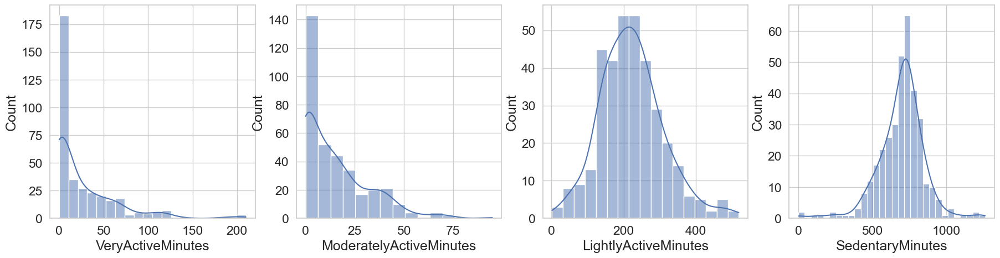

In [44]:
fig, axes = plt.subplots(1, 4, figsize=(22, 5))
sns.histplot(data = df_merged, x = 'VeryActiveMinutes', ax = axes[0], kde=True);

sns.histplot(data = df_merged, x = 'ModeratelyActiveMinutes', ax = axes[1], kde=True);

sns.histplot(data = df_merged, x = 'LightlyActiveMinutes', ax = axes[2], kde=True);

sns.histplot(data = df_merged, x = 'SedentaryMinutes', ax = axes[3], kde=True);

LightActiveMinutes: 1.5-3 METS
ModeratelyActiveMinutes: 3-6 METs in at least 10 min
VeryActiveMinutes: > 6 METs or >= 145 steps/min in 10min

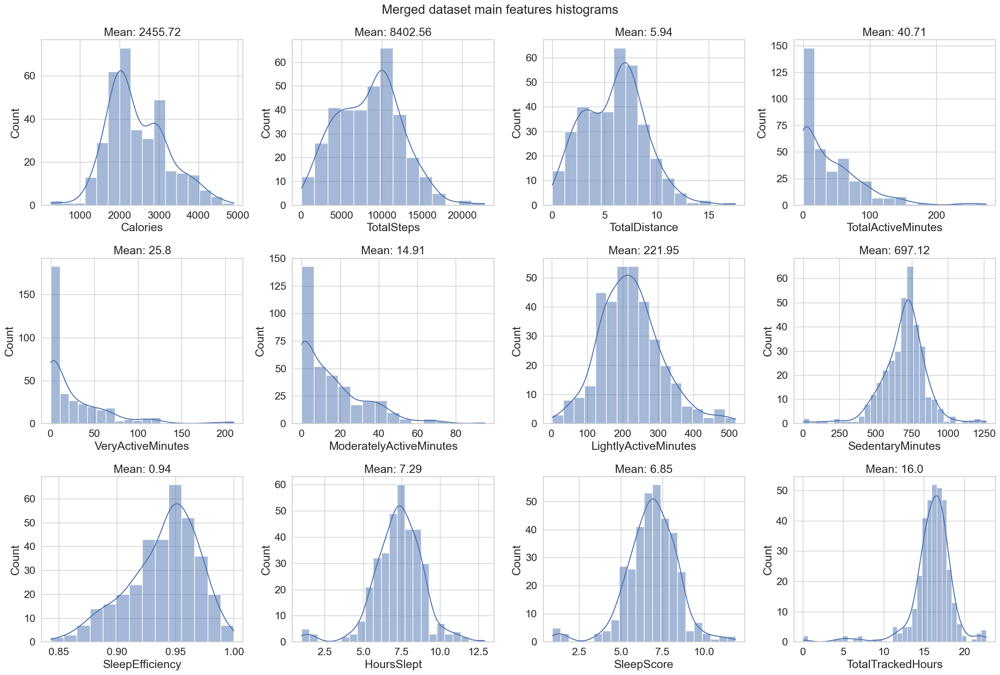

In [45]:
fig, axes = plt.subplots(3, 4, figsize=(22, 15))
fig.suptitle('Merged dataset main features histograms', fontsize=20)
columns = ['Calories', 'TotalSteps', 'TotalDistance', 'TotalActiveMinutes', 'VeryActiveMinutes', 'ModeratelyActiveMinutes', 'LightlyActiveMinutes', 'SedentaryMinutes', 'SleepEfficiency', 'HoursSlept', 'SleepScore', 'TotalTrackedHours']
for i, c in enumerate(columns):
    row = i // 4
    col = i % 4
    sns.histplot(data = df_merged, x = c, ax = axes[row][col], kde=True, );
    mean_value = df_merged[c].mean()
    axes[row][col].set_title(f"Mean: {round(mean_value, 2)}")
plt.tight_layout()
fig.savefig('figures/merged_histograms.png')

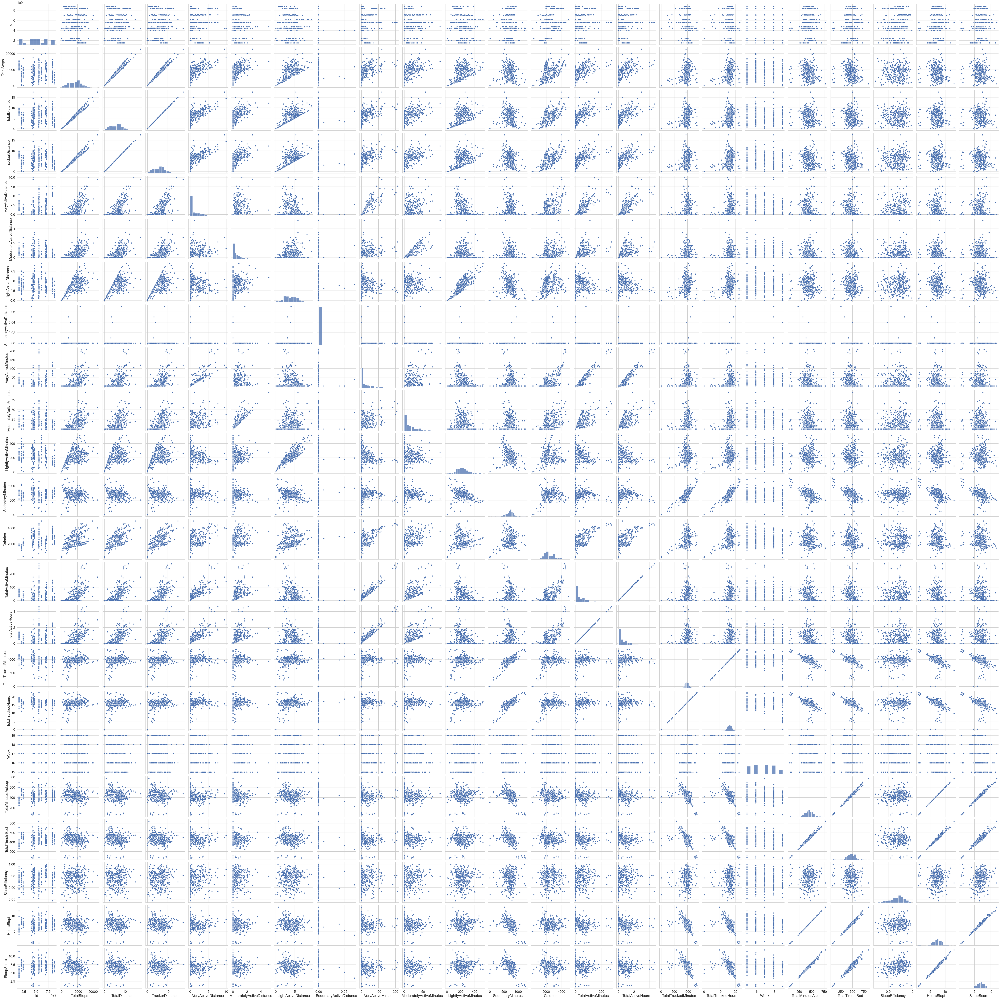

In [46]:
sns.pairplot(df_merged, height=3)

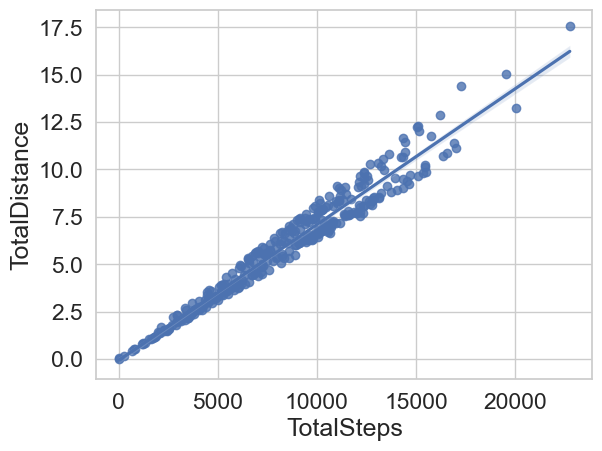

In [47]:
plot = sns.regplot(data=df_merged, x='TotalSteps', y='TotalDistance')
fig = plot.get_figure()
fig.savefig('figures/totalsteps_vs_totaldistance.png')

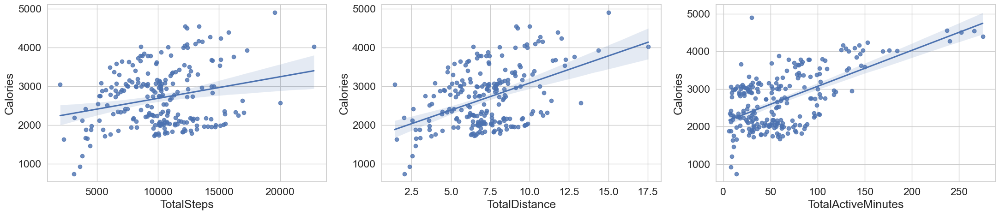

In [48]:
fig, axes = plt.subplots(1, 3, figsize=(22, 5))

df_m = df_merged.query('TotalActiveMinutes > 0')
ax[0]
ax[0].set_title(f'Corr: {df_m["TotalSteps"].corr(df_m["Calories"])}')
sns.regplot(data=df_m, x='TotalSteps', y='Calories', ax=axes[0])
sns.regplot(data=df_m, x='TotalDistance', y='Calories', ax=axes[1])
sns.regplot(data=df_m, x='TotalActiveMinutes', y='Calories', ax=axes[2])
plt.tight_layout()
fig.savefig('figures/linearities.png')

count    353.000000
mean     437.127479
std       97.614549
min       59.000000
25%      385.000000
50%      441.000000
75%      499.000000
max      775.000000
Name: TotalMinutesAsleep, dtype: float64


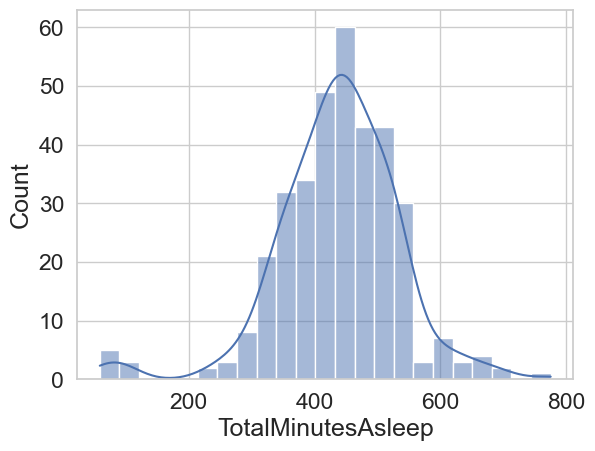

In [49]:
hist = sns.histplot(data=df_merged, x='TotalMinutesAsleep', kde=True)
hist.get_figure().savefig('figures/totalminutesasleep.png')
print(df_merged['TotalMinutesAsleep'].describe())

In [50]:
sns.set(style="whitegrid", font_scale=2.5)

,Date,Id,TotalSteps,TotalDistance,TrackerDistance,VeryActiveDistance,ModeratelyActiveDistance,LightActiveDistance,SedentaryActiveDistance,VeryActiveMinutes,ModeratelyActiveMinutes,LightlyActiveMinutes,SedentaryMinutes,Calories,Weekday,TotalActiveMinutes,TotalActiveHours,TotalTrackedMinutes,TotalTrackedHours,ActivityType,Week,TotalMinutesAsleep,TotalTimeInBed,SleepEfficiency,HoursSlept,SleepType,SleepScore
0,2016-04-12,1503960366,13162,8.5,8.5,1.88,0.55,6.06,0.0,25,13,328,728,1985,Tuesday,38,0.633333,1094,18.233333,Inactive,15,327,346,0.945087,5.45,Inadequate,5.150723


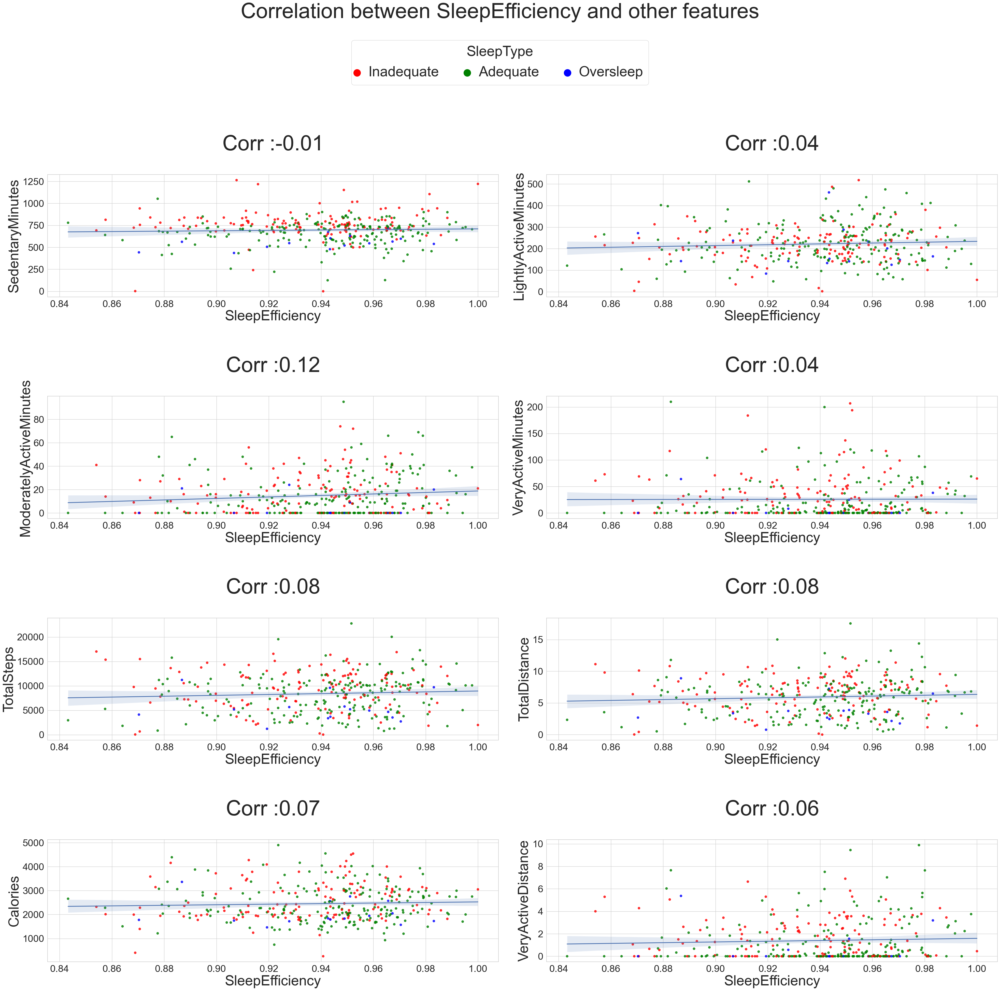

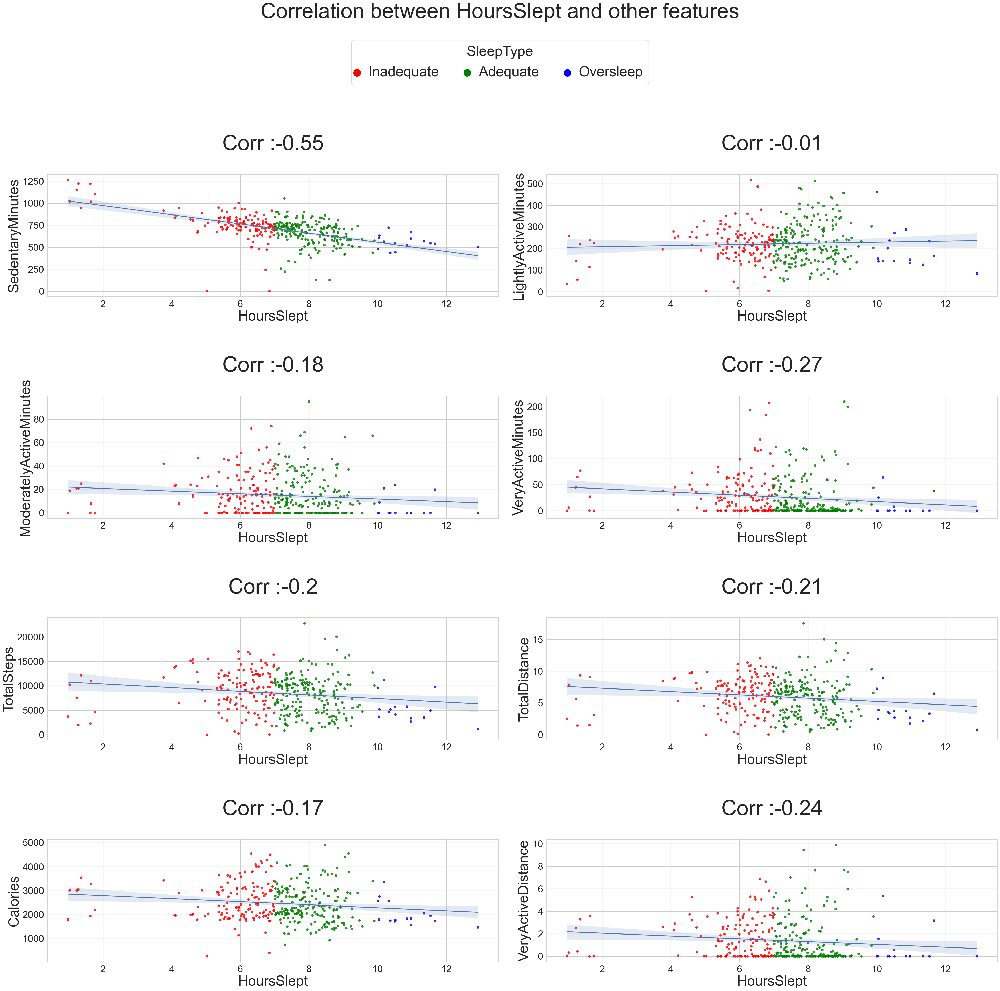

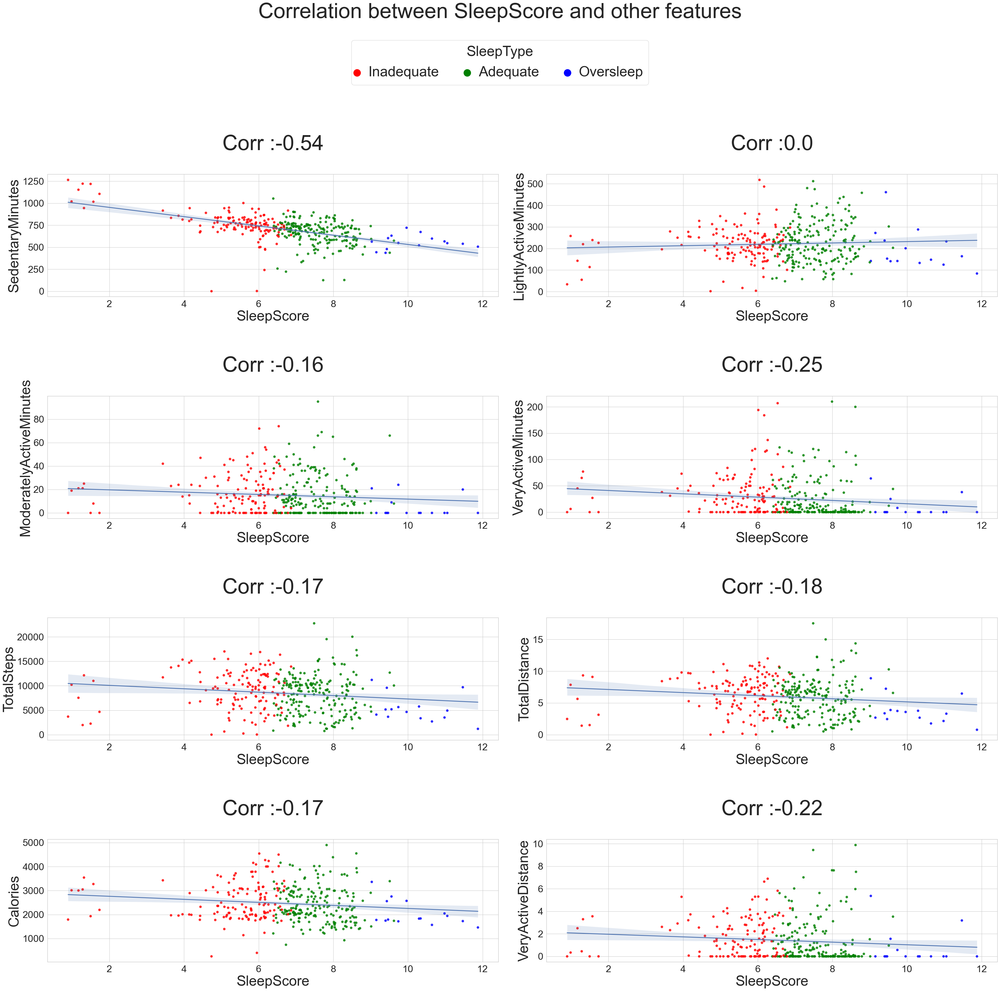

In [51]:
display(df_merged.head(1))
cols = ['SleepEfficiency', 'HoursSlept', 'SleepScore']

for v in cols:
    fig, ax = plt.subplots(nrows=4, ncols=2, figsize=(40, 40))
    fig.suptitle(f'Correlation between {v} and other features\n\n\n\n', fontsize=60)
    
    color_map =  df_merged['SleepType'].map({'Inadequate': 'red', 'Adequate': 'green', 'Oversleep': 'blue'}).to_list()

    # Create regression plots and scatter plots for the legend
    scatter1 = ax[0][0].scatter([], [], color='red', label='Inadequate', s=400)
    scatter2 = ax[0][0].scatter([], [], color='green', label='Adequate', s=400)
    scatter3 = ax[0][0].scatter([], [], color='blue', label='Oversleep', s=400)

    
    ax_f_size = 40
    corr_f_size = 60
    label_f_size = 40

    # Create legend
    # Create legend with custom scatterpoints and marker size
    fig.legend(handles=[scatter1, scatter2, scatter3], bbox_to_anchor=(0.5, 0.95), \
               loc='upper center', title='SleepType', ncols=3, title_fontsize=label_f_size,\
                  fontsize=label_f_size, scatterpoints=1, handlelength=0)


    
    ax[0][0].set_xlabel(v, fontsize=ax_f_size)
    ax[0][0].set_ylabel('SedentaryMinutes', fontsize=ax_f_size)

    ax[0][1].set_xlabel(v, fontsize=ax_f_size)
    ax[0][1].set_ylabel('LightlyActiveMinutes', fontsize=ax_f_size)

    ax[1][0].set_xlabel(v, fontsize=ax_f_size)
    ax[1][0].set_ylabel('ModeratelyActiveMinutes', fontsize=ax_f_size)

    ax[1][1].set_xlabel(v, fontsize=ax_f_size)
    ax[1][1].set_ylabel('VeryActiveMinutes', fontsize=ax_f_size)

    ax[2][0].set_xlabel(v, fontsize=ax_f_size)
    ax[2][0].set_ylabel('TotalSteps', fontsize=ax_f_size)

    ax[2][1].set_xlabel(v, fontsize=ax_f_size)
    ax[2][1].set_ylabel('TotalDistance', fontsize=ax_f_size)

    ax[3][0].set_xlabel(v, fontsize=ax_f_size)
    ax[3][0].set_ylabel('Calories', fontsize=ax_f_size)

    ax[3][1].set_xlabel(v, fontsize=ax_f_size)
    ax[3][1].set_ylabel('TotalTrackedHours', fontsize=ax_f_size)


    sns.regplot(data=df_merged, x=v, y='SedentaryMinutes', ax=ax[0][0], scatter_kws={'color':color_map})
    ax[0][0].set_title(f'\nCorr :{round(df_merged[v].corr(df_merged["SedentaryMinutes"], method="spearman"), 2)}\n', fontsize=corr_f_size)
    sns.regplot(data=df_merged, x=v, y='LightlyActiveMinutes', ax=ax[0][1], scatter_kws={'color':color_map})
    ax[0][1].set_title(f'\nCorr :{round(df_merged[v].corr(df_merged["LightlyActiveMinutes"], method="spearman"), 2)}\n', fontsize=corr_f_size)
    sns.regplot(data=df_merged, x=v, y='ModeratelyActiveMinutes', ax=ax[1][0], scatter_kws={'color':color_map})
    ax[1][0].set_title(f'\nCorr :{round(df_merged[v].corr(df_merged["ModeratelyActiveMinutes"], method="spearman"), 2)}\n', fontsize=corr_f_size)
    sns.regplot(data=df_merged, x=v, y='VeryActiveMinutes', ax=ax[1][1], scatter_kws={'color':color_map})
    ax[1][1].set_title(f'\nCorr :{round(df_merged[v].corr(df_merged["VeryActiveMinutes"], method="spearman"), 2)}\n', fontsize=corr_f_size)
    sns.regplot(data=df_merged, x=v, y='TotalSteps', ax=ax[2][0], scatter_kws={'color':color_map})
    ax[2][0].set_title(f'\nCorr :{round(df_merged[v].corr(df_merged["TotalSteps"], method="spearman"), 2)}\n', fontsize=corr_f_size)
    sns.regplot(data=df_merged, x=v, y='TotalDistance', ax=ax[2][1], scatter_kws={'color':color_map})
    ax[2][1].set_title(f'\nCorr :{round(df_merged[v].corr(df_merged["TotalDistance"], method="spearman"), 2)}\n', fontsize=corr_f_size)
    sns.regplot(data=df_merged, x=v, y='Calories', ax=ax[3][0], scatter_kws={'color':color_map})
    ax[3][0].set_title(f'\nCorr :{round(df_merged[v].corr(df_merged["Calories"], method="spearman"), 2)}\n', fontsize=corr_f_size)
    sns.regplot(data=df_merged, x=v, y='VeryActiveDistance', ax=ax[3][1], scatter_kws={'color':color_map})
    ax[3][1].set_title(f'\nCorr :{round(df_merged[v].corr(df_merged["VeryActiveDistance"], method="spearman"), 2)}\n', fontsize=corr_f_size)
    plt.tight_layout()
    plt.show()
    fig.savefig(f'figures/correlation_{v}_sleep.png')

# Full correlation matrix

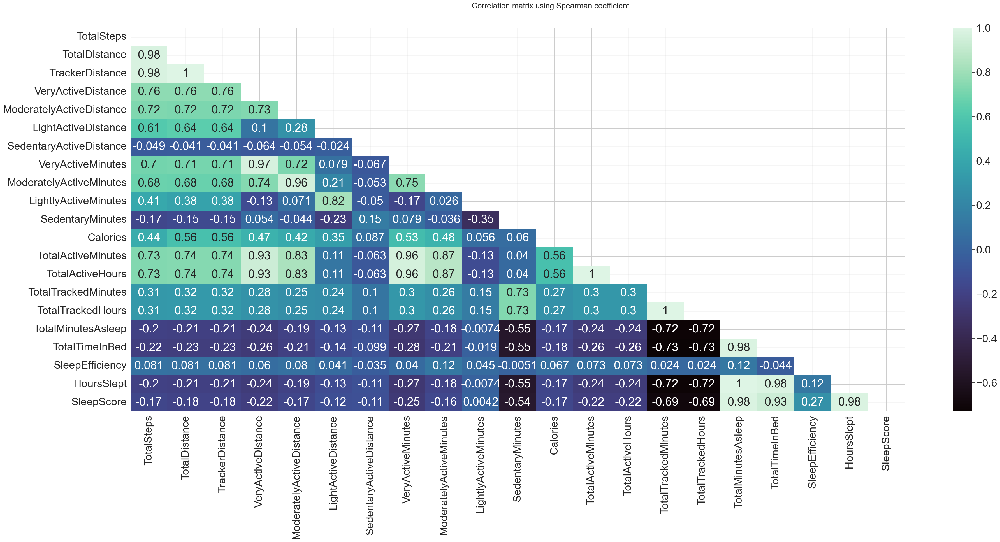

In [52]:
corr_df = df_merged.drop(columns=['Weekday', 'ActivityType', 'SleepType', 'Id', 'Date', 'Week'])
corr_matrix = corr_df.corr(method='spearman')
mask = np.triu(np.ones_like(corr_matrix, dtype=bool))
plt.figure(figsize=(40, 20))
sns.heatmap(corr_matrix, annot=True, cmap='mako', mask=mask)
plt.suptitle('Correlation matrix using Spearman coefficient', fontsize=20)
plt.tight_layout()
fig.savefig('figures/full_correlation_matrix.png')

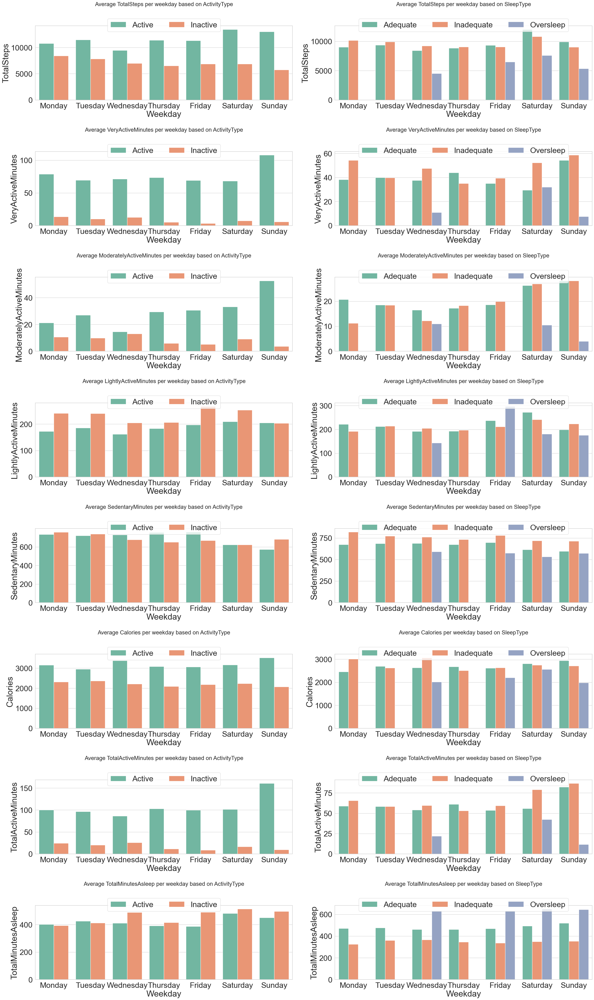

In [53]:
df_steps_weekday = df_merged.groupby(['Weekday', 'ActivityType', 'SleepType']).\
    agg({'TotalSteps': 'mean', 'VeryActiveMinutes':'mean', \
    'ModeratelyActiveMinutes':'mean', 'LightlyActiveMinutes':'mean',\
    'SedentaryMinutes':'mean', 'Calories':'mean',   \
    'TotalActiveMinutes':'mean', 'TotalMinutesAsleep':'mean' }).reset_index()

cols = df_steps_weekday.columns[3:]
fig, ax = plt.subplots(figsize=(30, 50), nrows=8, ncols=2)
for i, col in enumerate(cols):
    ax[i][0].set_title(f'Average {col} per weekday based on ActivityType\n\n\n', fontsize=20)
    sns.barplot(data=df_steps_weekday, x='Weekday', y=col, palette='Set2',hue='ActivityType', order=days_ord, ax=ax[i][0], errorbar=None, zorder=2)
    ax[i][0].legend(bbox_to_anchor=(0.5, 1.15), loc='upper center', ncol=2)
    sns.barplot(data=df_steps_weekday, x='Weekday', y=col, palette='Set2',hue='SleepType', order=days_ord, ax=ax[i][1], errorbar=None, zorder=2)
    ax[i][1].set_title(f'Average {col} per weekday based on SleepType\n\n\n', fontsize=20)
    ax[i][1].legend(bbox_to_anchor=(0.5, 1.15), loc='upper center', ncol=3)
plt.tight_layout()
fig.savefig('figures/avg_cols_based_on_activity.png')

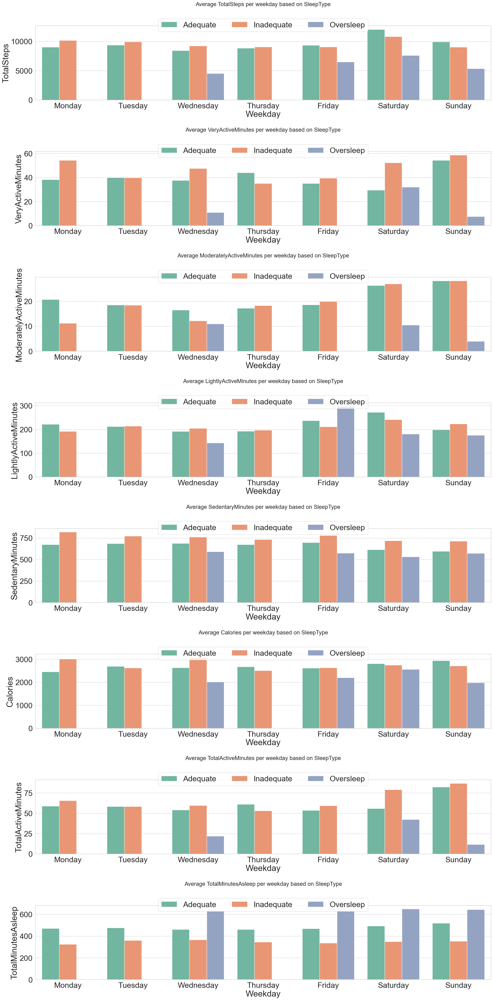

In [54]:
df_steps_weekday = df_merged.groupby(['Weekday', 'ActivityType', 'SleepType']).\
    agg({'TotalSteps': 'mean', 'VeryActiveMinutes':'mean', \
    'ModeratelyActiveMinutes':'mean', 'LightlyActiveMinutes':'mean',\
    'SedentaryMinutes':'mean', 'Calories':'mean',   \
    'TotalActiveMinutes':'mean', 'TotalMinutesAsleep':'mean' }).reset_index()

cols = df_steps_weekday.columns[3:]
fig, ax = plt.subplots(figsize=(25, 50), nrows=8, ncols=1)
for i, col in enumerate(cols):
    sns.barplot(data=df_steps_weekday, x='Weekday', y=col, palette='Set2',hue='SleepType', order=days_ord, ax=ax[i], errorbar=None, zorder=2)
    ax[i].set_title(f'Average {col} per weekday based on SleepType\n\n\n', fontsize=20)
    ax[i].legend(bbox_to_anchor=(0.5, 1.15), loc='upper center', ncol=3)
plt.tight_layout()
fig.savefig('figures/avg_cols_based_on_sleep.png')

In [55]:
df_sleep.groupby('SleepType')['Weekday'].value_counts()

SleepType   Weekday  
Adequate    Wednesday    41
            Thursday     33
            Sunday       31
            Tuesday      29
            Monday       26
            Saturday     24
            Friday       21
Inadequate  Tuesday      28
            Friday       25
            Thursday     24
            Saturday     18
            Monday       16
            Wednesday    15
            Sunday       10
Oversleep   Saturday      5
            Sunday        5
            Wednesday     3
            Friday        2
Name: count, dtype: int64

Index(['2016-04-12, Tuesday', '2016-04-13, Wednesday', '2016-04-14, Thursday',
       '2016-04-15, Friday', '2016-04-16, Saturday', '2016-04-17, Sunday',
       '2016-04-18, Monday', '2016-04-19, Tuesday', '2016-04-20, Wednesday',
       '2016-04-21, Thursday', '2016-04-22, Friday', '2016-04-23, Saturday',
       '2016-04-24, Sunday', '2016-04-25, Monday', '2016-04-26, Tuesday',
       '2016-04-27, Wednesday', '2016-04-28, Thursday', '2016-04-29, Friday',
       '2016-04-30, Saturday', '2016-05-01, Sunday', '2016-05-02, Monday',
       '2016-05-03, Tuesday', '2016-05-04, Wednesday', '2016-05-05, Thursday',
       '2016-05-06, Friday', '2016-05-07, Saturday', '2016-05-08, Sunday',
       '2016-05-09, Monday', '2016-05-10, Tuesday', '2016-05-11, Wednesday',
       '2016-05-12, Thursday'],
      dtype='object', name='Date')
(15, 31)


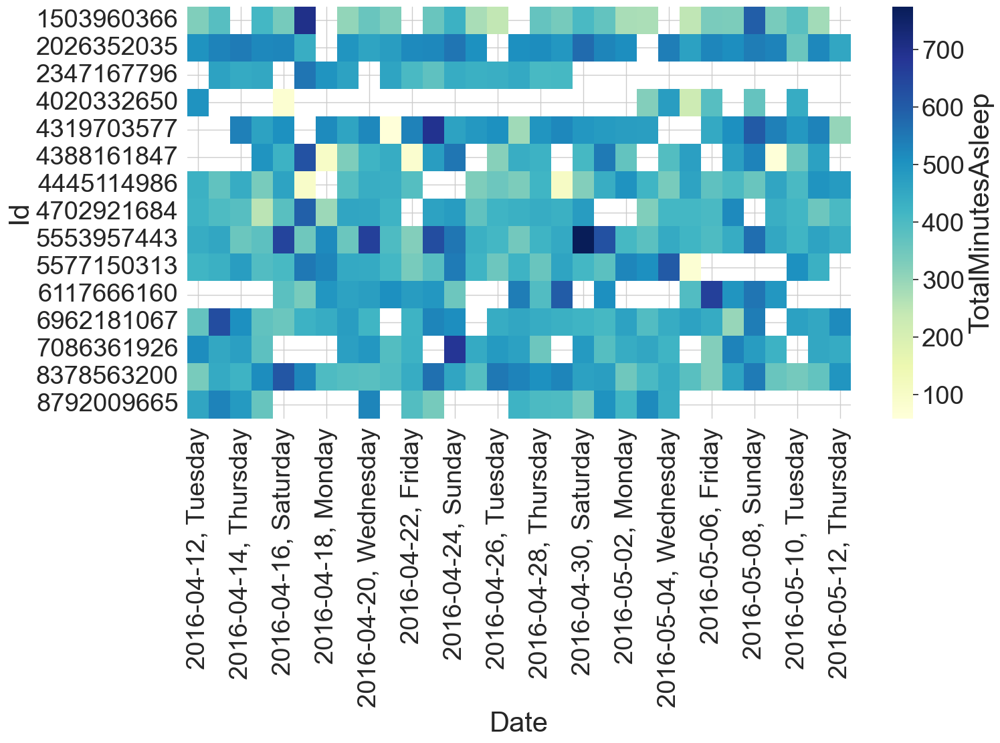

In [56]:
pivot = df_merged.pivot(index='Id', columns='Date', values='TotalMinutesAsleep')
pivot.columns = pivot.columns.strftime('%Y-%m-%d, %A')
print(pivot.columns)
print(pivot.shape)
pivot.isnull().sum().sum()
plt.figure(figsize=(16,8))
sns.heatmap(data=pivot, cmap="YlGnBu",  cbar_kws={'label': 'TotalMinutesAsleep'})
plt.show()

# Considering user 8378563200

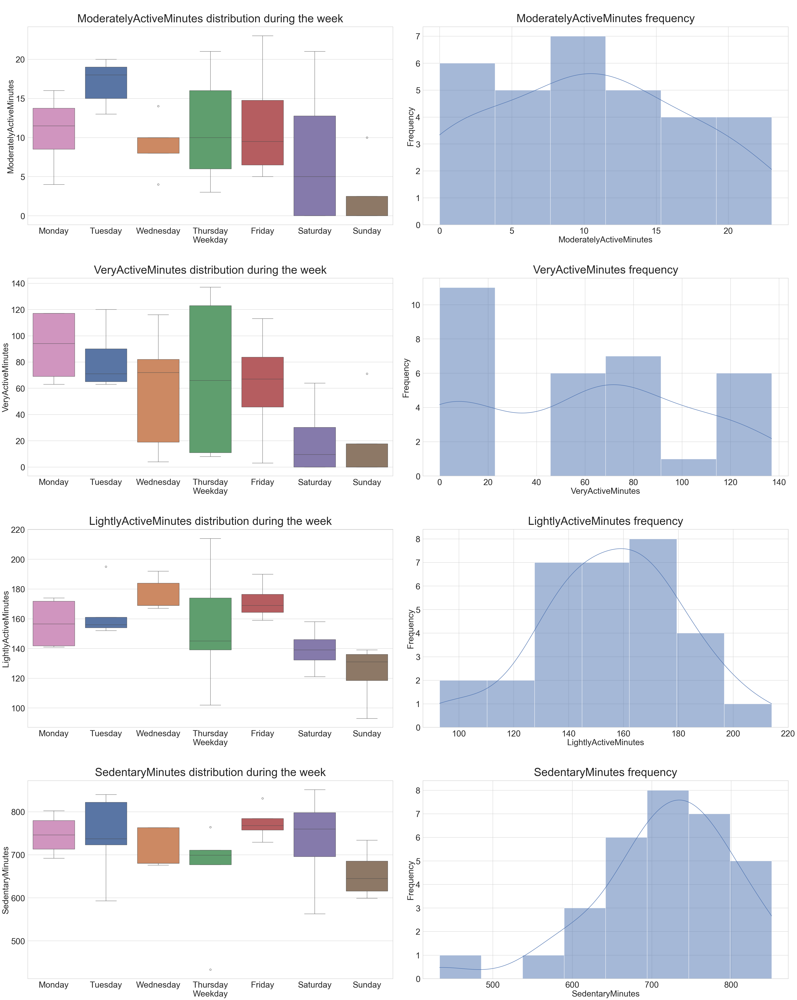

In [57]:
# Analysis on merged dataset
user_id = 8378563200
user_df = df_merged[df_merged['Id'] == user_id]
cols = ['ModeratelyActiveMinutes', 'VeryActiveMinutes', 'LightlyActiveMinutes', 'SedentaryMinutes']
fig, ax = plt.subplots(figsize=(40, 50), nrows=len(cols), ncols=2)
for i, c in enumerate(cols):
    ax[i][0].set_title(f'\n{c} distribution during the week\n\n', fontsize=40, va='center', ha='center')
    ax[i][1].set_title(f'\n{c} frequency\n\n', fontsize=40, va='center', ha='center')
    sns.boxplot(data=user_df, x='Weekday', y=c, hue='Weekday', order=days_ord, ax=ax[i][0])
    sns.histplot(data=user_df, x=c, kde=True, ax=ax[i][1])
    ax[i][0].set_xlabel("Weekday",fontsize=30)
    ax[i][0].set_ylabel(c,fontsize=30) 
    ax[i][1].set_xlabel(c,fontsize=30)
    ax[i][1].set_ylabel("Frequency",fontsize=30)
    ax[i][0].tick_params(labelsize=30)
    ax[i][1].tick_params(labelsize=30)
plt.tight_layout()
fig.savefig(f'figures/user_{user_id}_activity_distribution.png')

Index(['Date', 'Id', 'TotalSteps', 'TotalDistance', 'TrackerDistance',
       'VeryActiveDistance', 'ModeratelyActiveDistance', 'LightActiveDistance',
       'SedentaryActiveDistance', 'VeryActiveMinutes',
       'ModeratelyActiveMinutes', 'LightlyActiveMinutes', 'SedentaryMinutes',
       'Calories', 'Weekday', 'TotalActiveMinutes', 'TotalActiveHours',
       'TotalTrackedMinutes', 'TotalTrackedHours', 'ActivityType', 'Week',
       'TotalMinutesAsleep', 'TotalTimeInBed', 'SleepEfficiency', 'HoursSlept',
       'SleepType', 'SleepScore'],
      dtype='object')


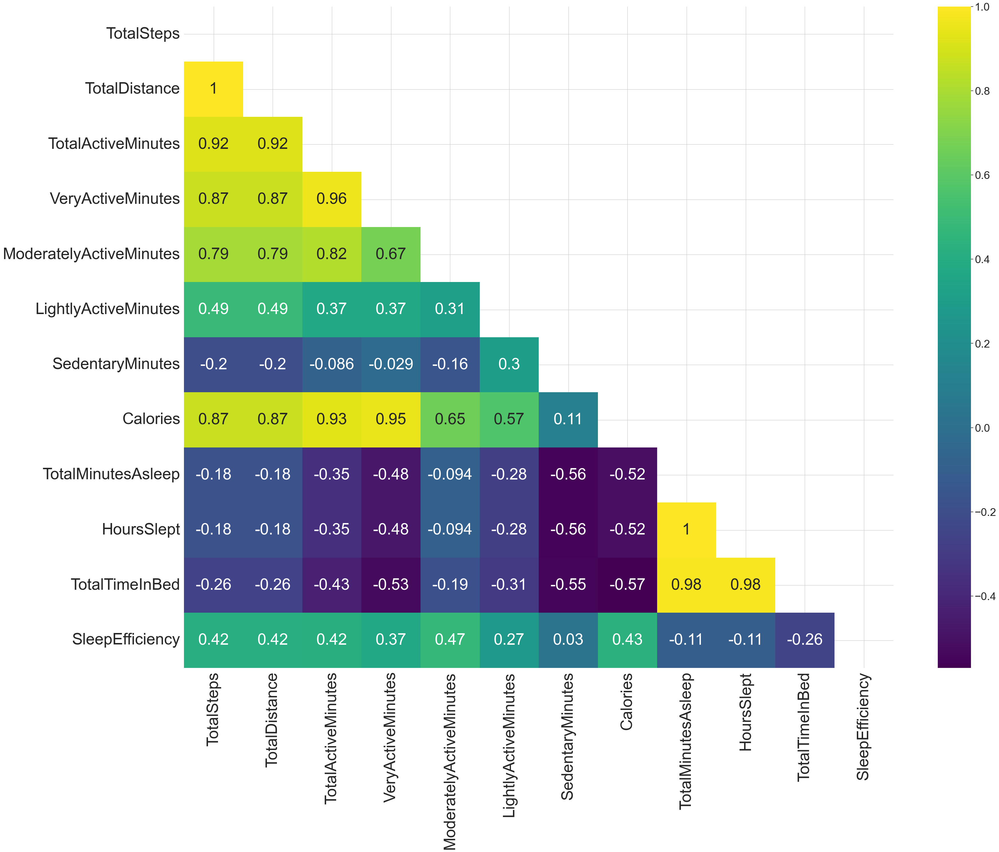

In [58]:
print(user_df.columns)
vars = ['TotalSteps', 'TotalDistance', 'TotalActiveMinutes', 'VeryActiveMinutes', 'ModeratelyActiveMinutes',\
         'LightlyActiveMinutes', 'SedentaryMinutes','Calories', 'TotalMinutesAsleep', 'HoursSlept', 'TotalTimeInBed','SleepEfficiency']
corr_mat = user_df[vars].corr(method='spearman')
fig, ax = plt.subplots(figsize=(40, 30))
mask = np.triu(np.ones_like(corr_mat, dtype=bool))
hmap = sns.heatmap(corr_mat, annot=True, cmap='viridis', mask=mask, annot_kws={'size':40})
ax.tick_params(axis='both', which='major', labelsize=40)
hmap.get_figure().savefig('figures/spearman_correlation_matrix.png')

Index(['Date', 'Id', 'TotalSteps', 'TotalDistance', 'TrackerDistance',
       'VeryActiveDistance', 'ModeratelyActiveDistance', 'LightActiveDistance',
       'SedentaryActiveDistance', 'VeryActiveMinutes',
       'ModeratelyActiveMinutes', 'LightlyActiveMinutes', 'SedentaryMinutes',
       'Calories', 'Weekday', 'TotalActiveMinutes', 'TotalActiveHours',
       'TotalTrackedMinutes', 'TotalTrackedHours', 'ActivityType', 'Week',
       'TotalMinutesAsleep', 'TotalTimeInBed', 'SleepEfficiency', 'HoursSlept',
       'SleepType', 'SleepScore'],
      dtype='object')


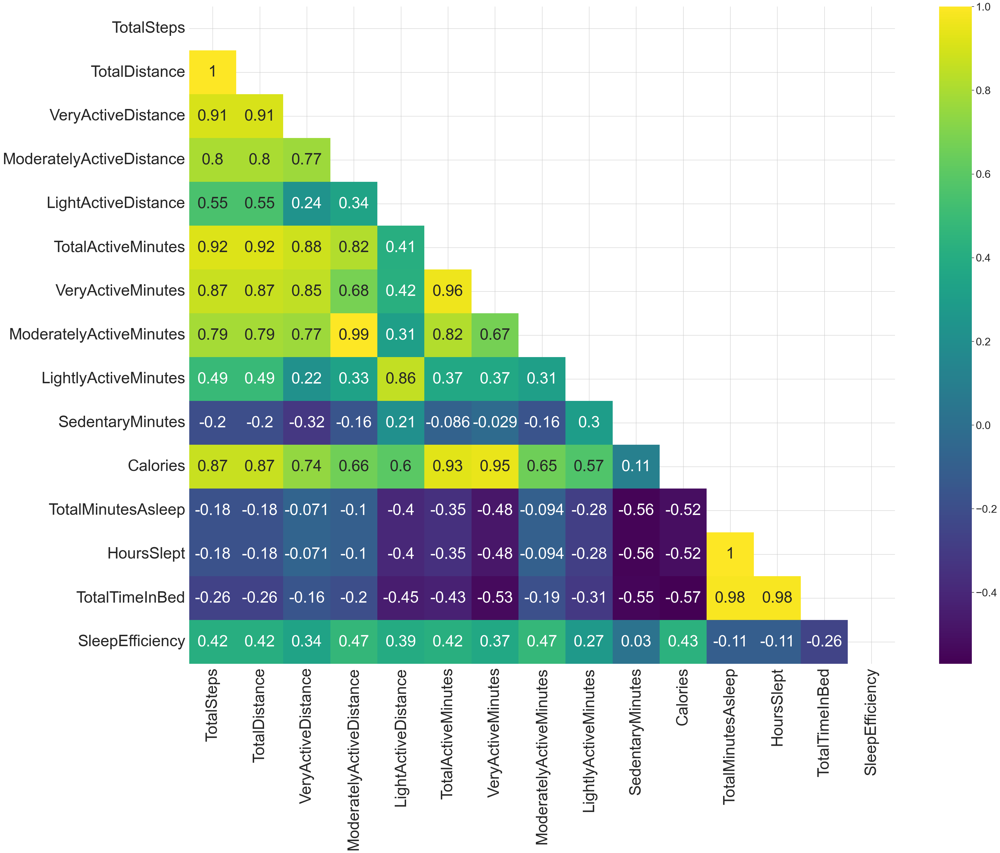

In [59]:
print(user_df.columns)
vars = ['TotalSteps', 'TotalDistance', 'VeryActiveDistance', 'ModeratelyActiveDistance', 'LightActiveDistance',\
         'TotalActiveMinutes', 'VeryActiveMinutes', 'ModeratelyActiveMinutes',\
         'LightlyActiveMinutes', 'SedentaryMinutes','Calories', 'TotalMinutesAsleep', 'HoursSlept', 'TotalTimeInBed','SleepEfficiency']
corr_mat = user_df[vars].corr(method='spearman')
fig, ax = plt.subplots(figsize=(40, 30))
mask = np.triu(np.ones_like(corr_mat, dtype=bool))
hmap = sns.heatmap(corr_mat, annot=True, cmap='viridis', mask=mask, annot_kws={'size':40})
ax.tick_params(axis='both', which='major', labelsize=40)
hmap.get_figure().savefig('figures/spearman_correlation_matrix_extended.png')


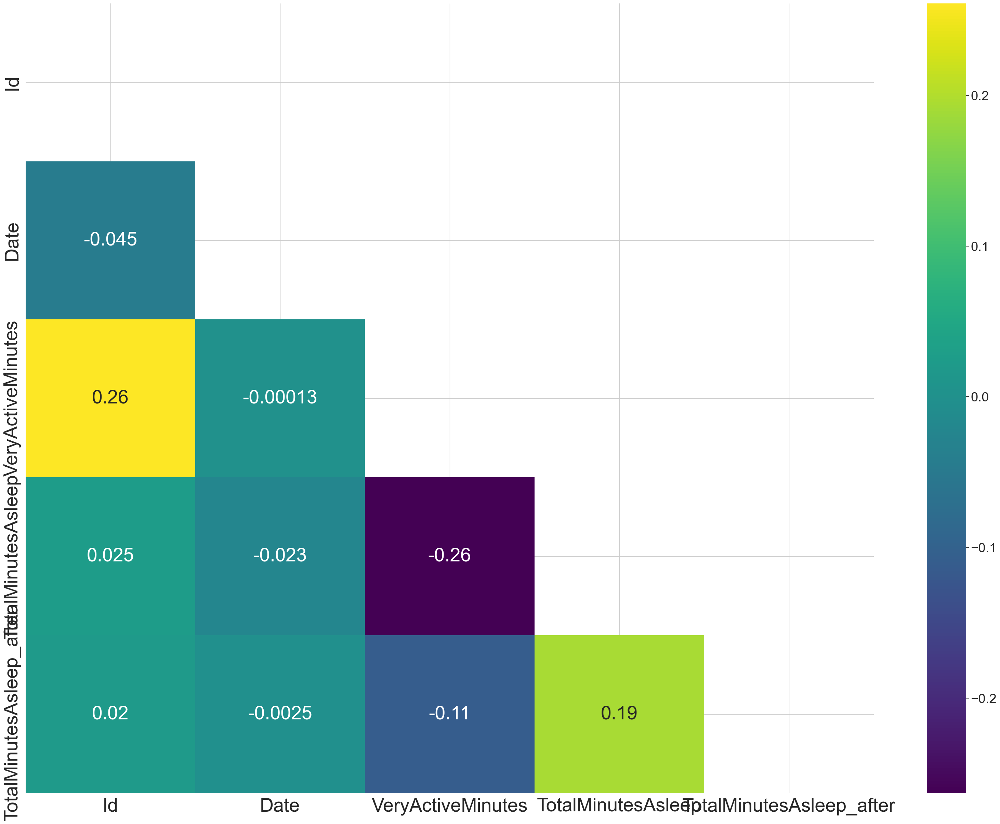

In [60]:
df_merged.head()
new_df = df_merged.copy(deep=True)

# Convert 'Date' column to datetime format
new_df['Date'] = pd.to_datetime(new_df['Date'])

# Calculate the date after each entry
new_df['Date_After'] = new_df['Date'] + pd.Timedelta(days=1)

# Merge the new dataframe with itself on the 'Date_After' and 'Id' columns
result_df = pd.merge(new_df, new_df[['Date', 'Id', 'TotalMinutesAsleep']], left_on=['Date_After', 'Id'], right_on=['Date', 'Id'], suffixes=('', '_after'))

# Drop unnecessary columns
result_df = result_df[['Id', 'Date', 'VeryActiveMinutes','TotalMinutesAsleep', 'TotalMinutesAsleep_after']]
result_df.head()
# Print or use the resulting dataframe 'result_df'
corr_mat = result_df.corr(method='spearman')
fig, ax = plt.subplots(figsize=(40, 30))
mask = np.triu(np.ones_like(corr_mat, dtype=bool))
hmap = sns.heatmap(corr_mat, annot=True, cmap='viridis', mask=mask, annot_kws={'size':40})
ax.tick_params(axis='both', which='major', labelsize=40)

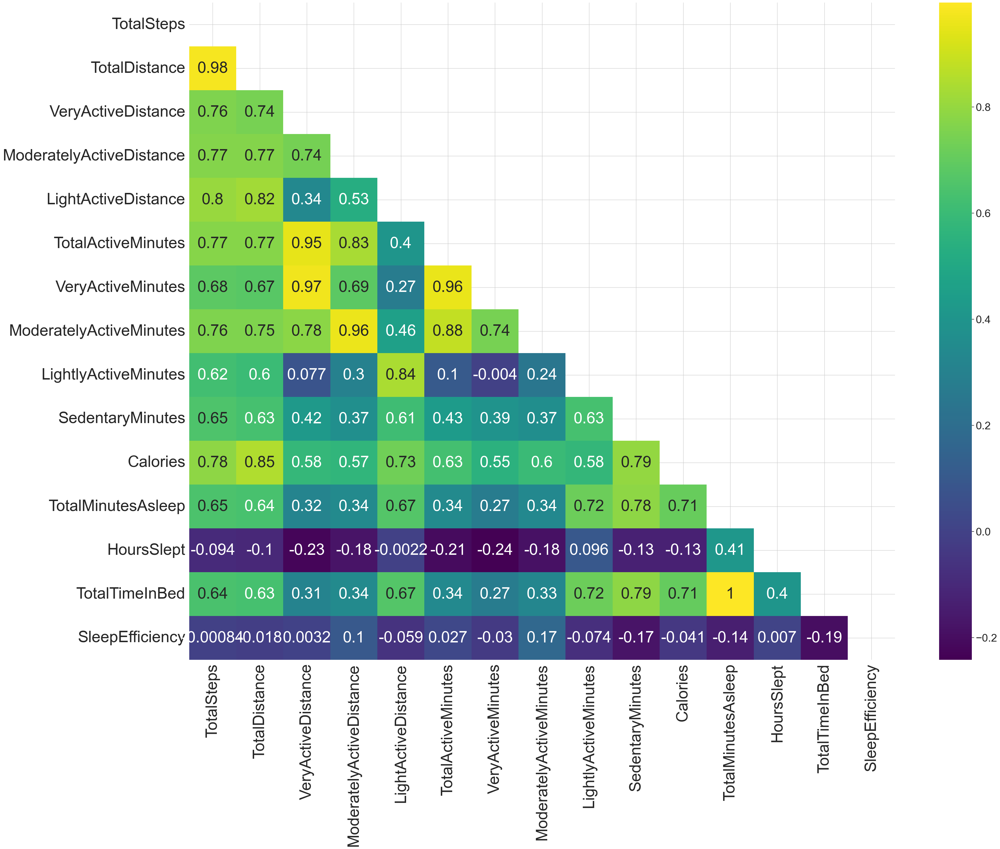

In [61]:
vars = ['TotalSteps', 'TotalDistance', 'VeryActiveDistance', 'ModeratelyActiveDistance', 'LightActiveDistance',\
         'TotalActiveMinutes', 'VeryActiveMinutes', 'ModeratelyActiveMinutes',\
         'LightlyActiveMinutes', 'SedentaryMinutes','Calories', 'TotalMinutesAsleep', 'HoursSlept', 'TotalTimeInBed','SleepEfficiency']
df_test = df_merged.groupby(['Id', pd.Grouper(key='Date', freq='7D')]).agg({
    'TotalSteps': 'sum',
    'TotalDistance': 'sum', 'VeryActiveDistance': 'sum', 'ModeratelyActiveDistance': 'sum', 'LightActiveDistance': 'sum',\
    'TotalActiveMinutes': 'sum', 'VeryActiveMinutes': 'sum', 'ModeratelyActiveMinutes': 'sum',\
    'LightlyActiveMinutes': 'sum', 'SedentaryMinutes': 'sum','Calories': 'sum', 'TotalMinutesAsleep': 'sum', 'HoursSlept': 'mean', 'TotalTimeInBed': 'sum','SleepEfficiency': 'mean',
    'SleepType': lambda x: x.value_counts().idxmax()
    }).reset_index()
corr_mat = df_test[vars].corr(method='spearman')
fig, ax = plt.subplots(figsize=(40, 30))
mask = np.triu(np.ones_like(corr_mat, dtype=bool))
hmap = sns.heatmap(corr_mat, annot=True, cmap='viridis', mask=mask, annot_kws={'size':40})
ax.tick_params(axis='both', which='major', labelsize=40)
hmap.get_figure().savefig('figures/spearman_correlation_matrix_extended.png')


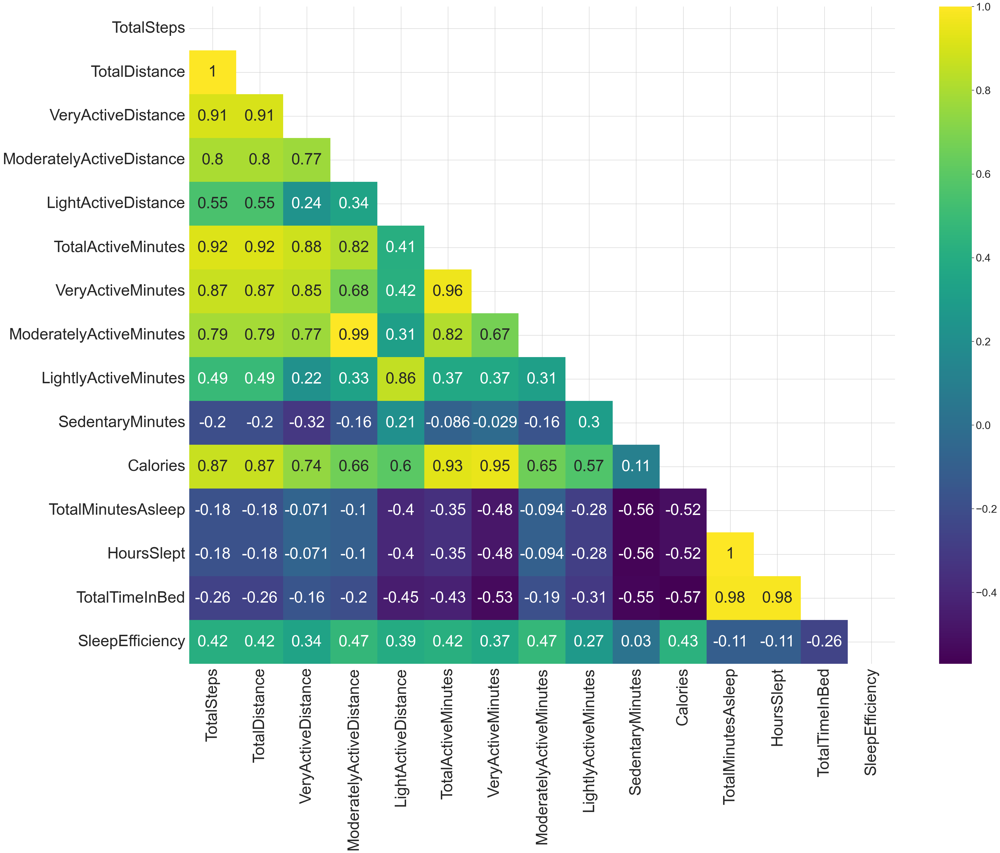

In [63]:
vars = ['TotalSteps', 'TotalDistance', 'VeryActiveDistance', 'ModeratelyActiveDistance', 'LightActiveDistance',\
         'TotalActiveMinutes', 'VeryActiveMinutes', 'ModeratelyActiveMinutes',\
         'LightlyActiveMinutes', 'SedentaryMinutes','Calories', 'TotalMinutesAsleep', 'HoursSlept', 'TotalTimeInBed','SleepEfficiency']
corr_mat = user_df[vars].corr(method='spearman')
fig, ax = plt.subplots(figsize=(40, 30))
mask = np.triu(np.ones_like(corr_mat, dtype=bool))
hmap = sns.heatmap(corr_mat, annot=True, cmap='viridis', mask=mask, annot_kws={'size':40})
ax.tick_params(axis='both', which='major', labelsize=40)
hmap.get_figure().savefig('figures/spearman_correlation_matrix_extended.png')


/var/folders/97/yjfp60y90vvgjz812_bx179m0000gn/T/ipykernel_91399/1894307527.py:3: UserWarning:

FigureCanvasAgg is non-interactive, and thus cannot be shown



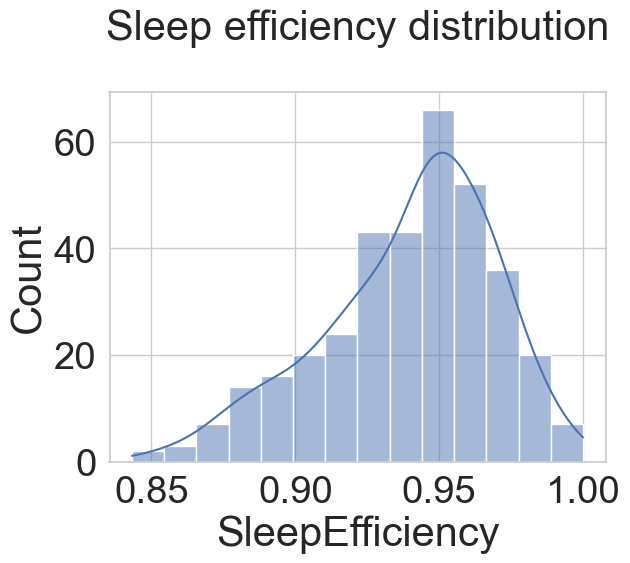

In [64]:
hist = sns.histplot(data=df_merged, x='SleepEfficiency', kde=True).set_title('Sleep efficiency distribution\n')
fig = hist.get_figure()
fig.show()
fig.savefig('figures/sleep_efficiency_distribution.png', dpi=300, bbox_inches='tight')

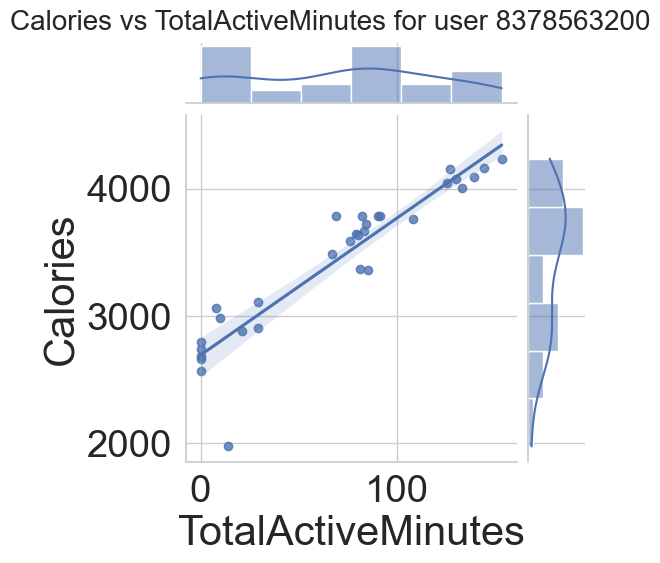

In [65]:
jp = sns.jointplot(data=user_df, y='Calories', x='TotalActiveMinutes', kind='reg')
jp.fig.suptitle(f'Calories vs TotalActiveMinutes for user {user_id}', fontsize=20)
jp.savefig('figures/jointplot_calories_vs_totalactiveminutes.png')

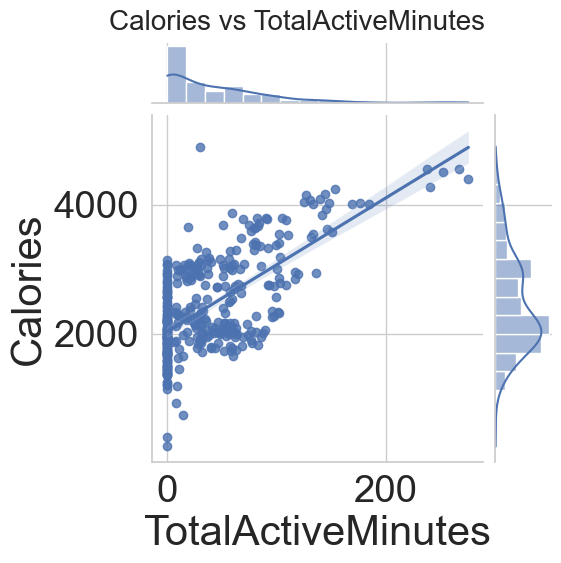

In [66]:
jp = sns.jointplot(data=df_merged, y='Calories', x='TotalActiveMinutes', kind='reg')
jp.fig.suptitle(f'Calories vs TotalActiveMinutes', fontsize=20)
jp.savefig('figures/jointplot_calories_vs_totalactiveminutes.png')

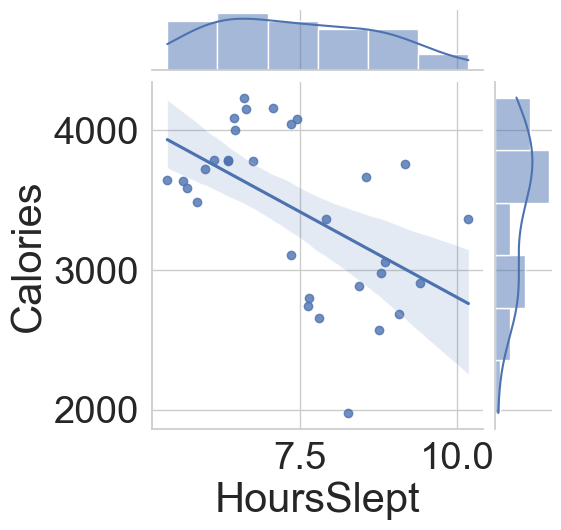

In [67]:
jp = sns.jointplot(data=user_df, y='Calories', x='HoursSlept', kind='reg')
jp.savefig('figures/jointplot_calories_vs_hoursslept.png')